# Part 1.a) Web Scraping 

## Scraping bookaremagic.com for book attributes 

### Attributes Scraped: Title, Author, Price, Sales Rank, Genre/Theme, Published Month, Published Year

In [3]:
#Importing the required libraries

import pandas as pd
from pandas import DataFrame
import numpy as np
import requests 
from bs4 import BeautifulSoup
from selenium import webdriver
from selenium.common.exceptions import NoSuchElementException
from selenium.webdriver.support.ui import Select
from selenium.webdriver.chrome.options import Options
import time

In [217]:
#Initiating a Headless browser

#Selecting chrome as webdriver
Options = webdriver.FirefoxOptions()
#Setting chrome headless
Options.set_headless()
browser = webdriver.Firefox(firefox_options = Options)


C:\Users\jibin\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:6: DeprecationWarning: use setter for headless property instead of set_headless
  
C:\Users\jibin\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:7: DeprecationWarning: use options instead of firefox_options
  import sys


In [189]:
from selenium.webdriver import Firefox
browser=Firefox()

In [197]:
#Connecting to server and getting page source
url ="https://www.booksaremagic.net/?q=h.tviewer&using_sb=status"


In [218]:
#Opening url through healdless browser and clicking on the tile list on the webpage as desired
browser.get(url)
detailed_list = browser.find_element_by_xpath("//div[@title='Detailed']")
detailed_list.click()


In [219]:
#Excluding to be released books
filter_to_be_released_books = browser.find_element_by_xpath("/html/body/div[6]/table[2]/tbody/tr/td/table/tbody/tr/td[1]/div/div[3]/div/div[1]/div[3]/div[3]/div[1]/img")
filter_to_be_released_books.click()

In [220]:
#Scraping required attributes using bs4 and selenium for approx 10K books that are in stock

books = []

#Outer loop to navigate 200 pages and inner loop to scrape every row from the webpage.

for i in range(1,201):
    page_source = browser.page_source
    soup = BeautifulSoup(page_source, "html.parser")
    for book in soup.find_all('tr',{"t1 gridsobcell"}):
        try:
            title = book.find('a',{'class':'grey atogsrus'}).text
            if len(title.split(":")) > 0:
                title = title.split(":")[0]
            else:
                None
            author = book.find('a',{'class':'grey togsrus'}).text
            price = book.find('div',{'style':'text-align:right; width:50px; vertical-align: middle;'}).text.split("$")[1]
            book_genre = book.find('div',{'class':'title_description'}).find_all('b')[-1].text
            month_published = book.find('div',{'class':'title_description'}).text.split("Published ")[1].split("\n")[0].split(" ")[0]
            year_published = book.find('div',{'class':'title_description'}).text.split("Published ")[1].split("\n")[0].split(", ")[1]
            try:
                sales_rank = book.find('img',{'style':'vertical-align:-2px;'}).findNext('span').text.split("#")[1]
                all_books_scraped = [title,author,price,sales_rank,book_genre,month_published,year_published]
                books.append(all_books_scraped)
            except:
                sales_rank = "NA"
                all_books_scraped = [title,author,price,sales_rank,book_genre,month_published,year_published]
                books.append(all_books_scraped)
        except:
            pass
    print("Finished Extracting Page:",i)
    try:
        select = Select(browser.find_element_by_class_name('quicknav')) 
        select.select_by_value(str(i))
    except:
        print("\nScraping Complete...")
        

Finished Extracting Page: 1
Finished Extracting Page: 2
Finished Extracting Page: 3
Finished Extracting Page: 4
Finished Extracting Page: 5
Finished Extracting Page: 6
Finished Extracting Page: 7
Finished Extracting Page: 8
Finished Extracting Page: 9
Finished Extracting Page: 10
Finished Extracting Page: 11
Finished Extracting Page: 12
Finished Extracting Page: 13
Finished Extracting Page: 14
Finished Extracting Page: 15
Finished Extracting Page: 16
Finished Extracting Page: 17
Finished Extracting Page: 18
Finished Extracting Page: 19
Finished Extracting Page: 20
Finished Extracting Page: 21
Finished Extracting Page: 22
Finished Extracting Page: 23
Finished Extracting Page: 24
Finished Extracting Page: 25
Finished Extracting Page: 26
Finished Extracting Page: 27
Finished Extracting Page: 28
Finished Extracting Page: 29
Finished Extracting Page: 30
Finished Extracting Page: 31
Finished Extracting Page: 32
Finished Extracting Page: 33
Finished Extracting Page: 34
Finished Extracting Pag

In [221]:
#Saving to a dataframe with appropriate column names
scraped_books = pd.DataFrame(books)
scraped_books.columns = ["Title","Author","Price","Sales Rank","Genre/Theme","Published Month","Published Year"]

In [222]:
scraped_books.shape

(9970, 7)

In [223]:
#Inspecting datatypes
scraped_books.dtypes

Title              object
Author             object
Price              object
Sales Rank         object
Genre/Theme        object
Published Month    object
Published Year     object
dtype: object

In [224]:
#Converting price from str to num
scraped_books['Price'] = scraped_books['Price'].astype(float)

In [227]:
scraped_books
#Approx 10K books scraped with 7 required attribute columns

,Title,Author,Price,Sales Rank,Genre/Theme,Published Month,Published Year
0,A Promised Land,Barack Obama,45.00,1,History,Nov,2020
1,Caste (Oprah's Book Club): The Origins of Our...,Isabel Wilkerson,28.80,2,History,Aug,2020
2,The Cold Millions: A Novel,Jess Walter,28.99,3,Fiction,Oct,2020
3,The Deep End (Diary of a Wimpy Kid Book 15),Jeff Kinney,13.49,4,Juvenile Fiction,Oct,2020
4,The Vanishing Half: A Novel,Brit Bennett,24.30,5,Fiction,Jun,2020
...,...,...,...,...,...,...,...
9965,The Young Bride: A Novel,Alessandro Baricco,16.00,NA,Fiction,Jul,2016
9966,Gris Grimly's Tales from the Brothers Grimm,Jacob and Wilhelm Grimm,17.99,NA,Juvenile Fiction,Jul,2016
9967,Bye Bye Blondie,Virginie Despentes,17.95,NA,Fiction,Jul,2016
9968,Let's Be Less Stupid: An Attempt to Maintain ...,Patricia Marx,14.99,NA,Self-Help,Jul,2016


In [228]:
#Exporting scraped book attributes to csv
scraped_books.to_csv('Scraped_Book_Attributes.csv')

# Part 1.b) Web Scraping 

## Scraping bookaremagic.com for book reviews 

### Data to be scraped: Book Title, Book Link, Top available critic reviews for each book

In [472]:
#Extracting the data from booksaremagic.com, available in json format using bs4

import requests
from bs4 import BeautifulSoup
import re

#On inspecting the network for the website, we found a link under the incoming traffic
#This link contains all reviews structured in json format

#Setting lim=500, for first 500 books
link = 'https://www.booksaremagic.net/?q=h.tviewer&using_sb=status&filt[status]=%20activenotcb%2C__instock&infscroll=1&&t=3&lim=10000&dm=7&using_sb=status&overridelim=1&dm=7&offs=0'

In [473]:
#Retreiving the link
req = requests.get(link)

#Using the data available in structured json format.
data_struct = req.json()

In [474]:
data_struct
#On inspecting, we can see that each row(rs) contains html information about 5 books

{'headers': [{'name': 'cov0', 'html': '', 'cj': 1, 'vt': 1, 'ow': 1, 'nbr': 1},
  {'name': 'cov1', 'html': '', 'cj': 1, 'vt': 1, 'ow': 1, 'nbr': 1},
  {'name': 'cov2', 'html': '', 'cj': 1, 'vt': 1, 'ow': 1, 'nbr': 1},
  {'name': 'cov3', 'html': '', 'cj': 1, 'vt': 1, 'ow': 1, 'nbr': 1},
  {'name': 'cov4', 'html': '', 'cj': 1, 'vt': 1, 'ow': 1}],
 'rs': [{'cov0': '<table class="noinher" cellspacing="0" cellpadding="0" style="margin: 0 auto; padding: 0;">\n  <tr>\n    <td style="height: 192px; width: 200px; vertical-align: bottom;">\n\n\n<div class="title_image" >\n  <A title="Click for more information (reviews, author bio, etc.)" CLASS="imglink togsrus" rel="iv0" href="?q=h.reports.tinf&rep=dd&eisbn=rgHmVQkJfJ4YZB3sH6mnzw&using_sb=status">\n      <IMG onclick="indicate_selected(this);" style="border: 1px solid #d0d0d0; margin-bottom: 5px;" align="middle" width="120" height="182" src="/i/b?b=rgHmVQkJfJ4YZB3sH6mnzw&cache=1605772097" alt="Cover image for Promised Land">\n  \n  </A>    </td

In [475]:
#Saving the html book data to a list
books1 = []
books_rows = data_struct["rs"]

#Outer loop to scrape set of 5books from the html code, Inner loop to scrape each row from the 5books
for rs in books_rows:
    for i in rs.values():
        soup1 = BeautifulSoup(i, "html.parser")
        #Scraping the book title
        title = soup1.find_all('b')[0].text
        #Scraping the book link
        link_book = soup1.find_all('a')[0]["href"]
        #Retrieving the link and html page for each book
        req = requests.get("https://www.booksaremagic.net/"+link_book+"&t=3")
        #Using the data available in structured json format.
        data_struct = req.json()
        book_webpage = "https://www.booksaremagic.net/"+link_book
        try:
            all_reviews_html = data_struct["rs"][0]["sr"]["iv"]["rs"][0]["tabdata"][3]["tab_body"]
            soup_reviews = BeautifulSoup(all_reviews_html, "html.parser").text
            reviews = soup_reviews
            all_books_scraped1 = [title,book_webpage,reviews]
            books1.append(all_books_scraped1)
        except:
            reviews = "Book has no reviews"
            all_books_scraped1 = [title,book_webpage,reviews]
            books1.append(all_books_scraped1)
        print("Scraped Reviews for Book: ",title)
        
        

Scraped Reviews for Book:  A Promised Land
Scraped Reviews for Book:  Caste (Oprah's Book Club)
Scraped Reviews for Book:  The Cold Millions
Scraped Reviews for Book:  The Deep End (Diary of a Wimpy Kid Book 15)
Scraped Reviews for Book:  The Vanishing Half
Scraped Reviews for Book:  The Best of Me
Scraped Reviews for Book:  Braiding Sweetgrass
Scraped Reviews for Book:  Untamed
Scraped Reviews for Book:  The Searcher
Scraped Reviews for Book:  How to Be an Antiracist
Scraped Reviews for Book:  Rhythm of War
Scraped Reviews for Book:  Dog Man
Scraped Reviews for Book:  Anxious People
Scraped Reviews for Book:  Transcendent Kingdom
Scraped Reviews for Book:  The Truths We Hold
Scraped Reviews for Book:  Greenlights
Scraped Reviews for Book:  Memorial
Scraped Reviews for Book:  Leave the World Behind
Scraped Reviews for Book:  So You Want to Talk About Race
Scraped Reviews for Book:  Mexican Gothic
Scraped Reviews for Book:  Solutions and Other Problems
Scraped Reviews for Book:  Circe
S

Scraped Reviews for Book:  Look Both Ways
Scraped Reviews for Book:  Dear Martin
Scraped Reviews for Book:  The One and Only Ivan
Scraped Reviews for Book:  Notorious RBG
Scraped Reviews for Book:  The Wild Iris
Scraped Reviews for Book:  Dog Man
Scraped Reviews for Book:  Dragons Love Tacos
Scraped Reviews for Book:  Entangled Life
Scraped Reviews for Book:  How to Write One Song
Scraped Reviews for Book:  Dragons and Marshmallows
Scraped Reviews for Book:  The Soul of an Octopus
Scraped Reviews for Book:  My Year of Rest and Relaxation
Scraped Reviews for Book:  White Tears/Brown Scars
Scraped Reviews for Book:  The Shadow King
Scraped Reviews for Book:  The Dutch House
Scraped Reviews for Book:  World of Wonders
Scraped Reviews for Book:  Last Stop on Market Street
Scraped Reviews for Book:  Sapiens
Scraped Reviews for Book:  Are Prisons Obsolete?
Scraped Reviews for Book:  Station Eleven
Scraped Reviews for Book:  She Come By It Natural
Scraped Reviews for Book:  Julian at the Wedd

Scraped Reviews for Book:  If Beale Street Could Talk
Scraped Reviews for Book:  The Dragonet Prophecy (Wings of Fire #1)
Scraped Reviews for Book:  All the Light We Cannot See
Scraped Reviews for Book:  Kristy's Great Idea (The Baby-Sitters Club Graphic Novel #1)
Scraped Reviews for Book:  People Who Love to Eat Are Always the Best People
Scraped Reviews for Book:  The Hole
Scraped Reviews for Book:  Harry Potter And The Prisoner Of Azkaban
Scraped Reviews for Book:  Hollowpox
Scraped Reviews for Book:  Sing, Unburied, Sing
Scraped Reviews for Book:  Guts
Scraped Reviews for Book:  The Book of Delights
Scraped Reviews for Book:  InvestiGators
Scraped Reviews for Book:  Becoming RBG
Scraped Reviews for Book:  Her Body and Other Parties
Scraped Reviews for Book:  Ottolenghi Simple
Scraped Reviews for Book:  Gideon the Ninth
Scraped Reviews for Book:  Light for the World to See
Scraped Reviews for Book:  The Princess in Black and the Perfect Princess Party
Scraped Reviews for Book:  Deat

Scraped Reviews for Book:  Ready Player One
Scraped Reviews for Book:  Press Here (Baby Board Book, Learning to Read Book, Toddler Board Book, Interactive Book for Kids)
Scraped Reviews for Book:  Attached
Scraped Reviews for Book:  Magic Treehouse # 2
Scraped Reviews for Book:  Wildwood
Scraped Reviews for Book:  Esperanza Rising (Scholastic Gold)
Scraped Reviews for Book:  InvestiGators
Scraped Reviews for Book:  The Monster at the End of This Book (Sesame Street)
Scraped Reviews for Book:  The Boy from the Woods
Scraped Reviews for Book:  Giovanni's Room
Scraped Reviews for Book:  We Are Never Meeting in Real Life.
Scraped Reviews for Book:  Little Women
Scraped Reviews for Book:  Grumpy Monkey Up All Night
Scraped Reviews for Book:  Olive Kitteridge
Scraped Reviews for Book:  The Plague
Scraped Reviews for Book:  Something Happened in Our Town
Scraped Reviews for Book:  Little Owl's Snow
Scraped Reviews for Book:  His Dark Materials
Scraped Reviews for Book:  Half of a Yellow Sun
S

Scraped Reviews for Book:  Crazy Stupid Bromance
Scraped Reviews for Book:  The Night Circus
Scraped Reviews for Book:  Mythopedia
Scraped Reviews for Book:  Sunshine
Scraped Reviews for Book:  The Quiet Americans
Scraped Reviews for Book:  Twilight of Democracy
Scraped Reviews for Book:  Big Nate
Scraped Reviews for Book:  Love in the Time of Cholera
Scraped Reviews for Book:  Percy Jackson and the Olympians, Book Five The Last Olympian (Percy Jackson and the Olympians, Book Five)
Scraped Reviews for Book:  Lost Children Archive
Scraped Reviews for Book:  Whale Day
Scraped Reviews for Book:  The Priory of the Orange Tree
Scraped Reviews for Book:  A Children's Bible
Scraped Reviews for Book:  Finding Latinx
Scraped Reviews for Book:  The Hunger Games (Hunger Games, Book One)
Scraped Reviews for Book:  1984
Scraped Reviews for Book:  Expecting Better
Scraped Reviews for Book:  Measuring Up
Scraped Reviews for Book:  Sibley Backyard Birding Puzzle
Scraped Reviews for Book:  Sabrina & Co

Scraped Reviews for Book:  Will You Be My Friend?
Scraped Reviews for Book:  The Left-Handed Booksellers of London
Scraped Reviews for Book:  Ten Arguments for Deleting Your Social Media Accounts Right Now
Scraped Reviews for Book:  Leviathan Wakes
Scraped Reviews for Book:  Max Meow Book 1
Scraped Reviews for Book:  The Idiot
Scraped Reviews for Book:  This Is the Way (Star Wars
Scraped Reviews for Book:  Save Me the Plums
Scraped Reviews for Book:  A Song Below Water
Scraped Reviews for Book:  Redwall
Scraped Reviews for Book:  The Mysterious Benedict Society and the Riddle of Ages
Scraped Reviews for Book:  Hope in the Dark
Scraped Reviews for Book:  Ultimate Shark Rumble (Who Would Win?)
Scraped Reviews for Book:  Jonny Lambert's Ten Little Reindeer
Scraped Reviews for Book:  Friends and Strangers
Scraped Reviews for Book:  The Heroes of Olympus, Book One The Lost Hero (new cover)
Scraped Reviews for Book:  Friends at the Firehouse
Scraped Reviews for Book:  In a Dark, Dark Room an

Scraped Reviews for Book:  Big Nate
Scraped Reviews for Book:  The Nom Wah Cookbook
Scraped Reviews for Book:  Timmy Failure
Scraped Reviews for Book:  Space Station Situation
Scraped Reviews for Book:  All Boys Aren't Blue
Scraped Reviews for Book:  The Gruffalo's Child
Scraped Reviews for Book:  Tiny T. Rex and the Impossible Hug (Dinosaur Books, Dinosaur Books for Kids, Dinosaur Picture Books, Read Aloud Family Books, Books for Young Children)
Scraped Reviews for Book:  Pet Sematary
Scraped Reviews for Book:  A Life on Our Planet
Scraped Reviews for Book:  The Low, Low Woods (Hill House Comics)
Scraped Reviews for Book:  Leadership
Scraped Reviews for Book:  Ty's Travels
Scraped Reviews for Book:  Kane Chronicles, The, Book One The Red Pyramid (The Kane Chronicles, Book One)
Scraped Reviews for Book:  Penderwicks
Scraped Reviews for Book:  Peek-A Who? (Lift the Flap Books, Interactive Books for Kids, Interactive Read Aloud Books)
Scraped Reviews for Book:  Empire of the Summer Moon


Scraped Reviews for Book:  Watch Over Me
Scraped Reviews for Book:  Octavia's Brood
Scraped Reviews for Book:  I Survived the Shark Attacks of 1916 (I Survived #2)
Scraped Reviews for Book:  Stoner
Scraped Reviews for Book:  Writing Down the Bones
Scraped Reviews for Book:  Nat Enough (Nat Enough #1)
Scraped Reviews for Book:  A Visit from the Goon Squad
Scraped Reviews for Book:  Violet Bent Backwards Over the Grass
Scraped Reviews for Book:  Genesis Begins Again
Scraped Reviews for Book:  The Stars and the Blackness Between Them
Scraped Reviews for Book:  A Manual for Cleaning Women
Scraped Reviews for Book:  Wolf Hall
Scraped Reviews for Book:  Mike Mulligan and His Steam Shovel
Scraped Reviews for Book:  Kitty and the Sky Garden Adventure
Scraped Reviews for Book:  Richard Scarry's What Do People Do All Day?
Scraped Reviews for Book:  In a Jar
Scraped Reviews for Book:  I Am Human
Scraped Reviews for Book:  No One Is Too Small to Make a Difference
Scraped Reviews for Book:  McGlue


Scraped Reviews for Book:  Pokemon Visual Companion Third Edition
Scraped Reviews for Book:  Exit West
Scraped Reviews for Book:  A Better Man
Scraped Reviews for Book:  Mockingjay
Scraped Reviews for Book:  Hope Rides Again
Scraped Reviews for Book:  Fish in a Tree
Scraped Reviews for Book:  Good Drinks
Scraped Reviews for Book:  Dragon's Merry Christmas
Scraped Reviews for Book:  Big Macs & Burgundy
Scraped Reviews for Book:  The Bad Guys in Superbad (The Bad Guys #8)
Scraped Reviews for Book:  Griffith's Guide for Dragon Masters
Scraped Reviews for Book:  Sontag
Scraped Reviews for Book:  Eva Evergreen, Semi-Magical Witch
Scraped Reviews for Book:  How Do You Dance?
Scraped Reviews for Book:  Pride and Prejudice
Scraped Reviews for Book:  Strega Nona
Scraped Reviews for Book:  The Woman Destroyed
Scraped Reviews for Book:  Long Way Down
Scraped Reviews for Book:  Roxy the Last Unisaurus Rex
Scraped Reviews for Book:  High School
Scraped Reviews for Book:  The Power of Habit
Scraped 

Scraped Reviews for Book:  The House of Hades (The Heroes of Olympus, Book Four (new cover)
Scraped Reviews for Book:  Percy Jackson and the Olympians The Last Olympian
Scraped Reviews for Book:  Awkward
Scraped Reviews for Book:  The Great Cow Race
Scraped Reviews for Book:  Pete the Cat
Scraped Reviews for Book:  The Crossover (Graphic Novel)
Scraped Reviews for Book:  Junie B. Jones #1
Scraped Reviews for Book:  Captain Underpants and the Attack of the Talking Toilets
Scraped Reviews for Book:  Paper Girls, Volume 2
Scraped Reviews for Book:  Celestial Large Decomposition Book
Scraped Reviews for Book:  The Butterfly Lampshade
Scraped Reviews for Book:  Golden Compass
Scraped Reviews for Book:  Hilo Book 2
Scraped Reviews for Book:  Yes No Maybe So
Scraped Reviews for Book:  Men We Reaped
Scraped Reviews for Book:  Compromised
Scraped Reviews for Book:  Autonomous
Scraped Reviews for Book:  The Princess Bride
Scraped Reviews for Book:  Jasmine Green Rescues
Scraped Reviews for Book:

Scraped Reviews for Book:  On Trails
Scraped Reviews for Book:  The Death and Life of Great American Cities
Scraped Reviews for Book:  Dog Days (Diary of a Wimpy Kid #4)
Scraped Reviews for Book:  One Year at Ellsmere
Scraped Reviews for Book:  Who Was Martin Luther King, Jr.?
Scraped Reviews for Book:  Olympians
Scraped Reviews for Book:  Seance Tea Party
Scraped Reviews for Book:  Finna
Scraped Reviews for Book:  An Unkindness of Ghosts
Scraped Reviews for Book:  Rising Strong
Scraped Reviews for Book:  Kim Gordon
Scraped Reviews for Book:  The Bad Guys in Intergalactic Gas (The Bad Guys #5)
Scraped Reviews for Book:  I'm a Frog! (An Elephant and Piggie Book)
Scraped Reviews for Book:  How to Argue With a Racist
Scraped Reviews for Book:  Classic Krakauer
Scraped Reviews for Book:  I Survived the Attack of the Grizzlies, 1967 (I Survived #17)
Scraped Reviews for Book:  George and Martha
Scraped Reviews for Book:  Recursion
Scraped Reviews for Book:  The Vanderbeekers Lost and Found
S

Scraped Reviews for Book:  Made Men
Scraped Reviews for Book:  Camp
Scraped Reviews for Book:  It's So Amazing!
Scraped Reviews for Book:  Aster and the Accidental Magic
Scraped Reviews for Book:  Pages & Co.
Scraped Reviews for Book:  You Think It, I'll Say It
Scraped Reviews for Book:  Sunny Side Up (Sunny, Book 1)
Scraped Reviews for Book:  This Isn't Happening
Scraped Reviews for Book:  Be Boy Buzz
Scraped Reviews for Book:  It Is Wood, It Is Stone
Scraped Reviews for Book:  I Hold a Wolf by the Ears
Scraped Reviews for Book:  Homesick for Another World
Scraped Reviews for Book:  The Lives of Saints
Scraped Reviews for Book:  Bibliophile
Scraped Reviews for Book:  The Water Cure
Scraped Reviews for Book:  Memorial Drive
Scraped Reviews for Book:  Boys & Sex
Scraped Reviews for Book:  Bo's Magical New Friend
Scraped Reviews for Book:  Watership Down
Scraped Reviews for Book:  We Have Always Lived in the Castle
Scraped Reviews for Book:  Chronicle of a Death Foretold
Scraped Reviews 

Scraped Reviews for Book:  Clementine
Scraped Reviews for Book:  The Terrible Two
Scraped Reviews for Book:  Medallion Status
Scraped Reviews for Book:  Jazz
Scraped Reviews for Book:  Backpack Explorer
Scraped Reviews for Book:  We Cast a Shadow
Scraped Reviews for Book:  I Survived #11
Scraped Reviews for Book:  The Secret of Platform 13
Scraped Reviews for Book:  Eva and the Lost Pony
Scraped Reviews for Book:  The Boatman's Daughter
Scraped Reviews for Book:  I Know Why the Caged Bird Sings
Scraped Reviews for Book:  A Room Called Earth
Scraped Reviews for Book:  Rebel Sisters
Scraped Reviews for Book:  Plenty
Scraped Reviews for Book:  Cleanness
Scraped Reviews for Book:  In the Night Kitchen
Scraped Reviews for Book:  The School of Life
Scraped Reviews for Book:  Busted in New York and Other Essays
Scraped Reviews for Book:  American Primitive
Scraped Reviews for Book:  The Penguin Book of Italian Short Stories
Scraped Reviews for Book:  Unicorn Crossing
Scraped Reviews for Book:

Scraped Reviews for Book:  Contrary Dogs
Scraped Reviews for Book:  It Feels Good to Be Yourself
Scraped Reviews for Book:  Always Look on the Bright Side of Life
Scraped Reviews for Book:  Uni Goes to School (Uni the Unicorn)
Scraped Reviews for Book:  Pea, Bee, & Jay #1
Scraped Reviews for Book:  See the Cat
Scraped Reviews for Book:  Jack and Santa
Scraped Reviews for Book:  White Noise
Scraped Reviews for Book:  Olympians
Scraped Reviews for Book:  How to Date Men When You Hate Men
Scraped Reviews for Book:  Parable of the Sower
Scraped Reviews for Book:  The Essential Rumi - reissue
Scraped Reviews for Book:  The Good Egg
Scraped Reviews for Book:  On Lighthouses
Scraped Reviews for Book:  Evil Spy School
Scraped Reviews for Book:  Lost in the City - 20th anniversary edition
Scraped Reviews for Book:  Over and Under the Snow
Scraped Reviews for Book:  The Brothers Karamazov
Scraped Reviews for Book:  Pity the Reader
Scraped Reviews for Book:  Kusama
Scraped Reviews for Book:  Inte

Scraped Reviews for Book:  Via Negativa
Scraped Reviews for Book:  Ivy and Bean What's the Big Idea? (Book 7)
Scraped Reviews for Book:  Men Without Women
Scraped Reviews for Book:  I Survived the Nazi Invasion, 1944 (I Survived #9)
Scraped Reviews for Book:  The Silver Swamp
Scraped Reviews for Book:  A Handbook of Disappointed Fate
Scraped Reviews for Book:  An Ember in the Ashes
Scraped Reviews for Book:  The Little House
Scraped Reviews for Book:  Dinner
Scraped Reviews for Book:  Geronimo Stilton # 1
Scraped Reviews for Book:  Younger Next Year for Women
Scraped Reviews for Book:  Renegades
Scraped Reviews for Book:  Difficult Women
Scraped Reviews for Book:  Truman
Scraped Reviews for Book:  A Saint from Texas
Scraped Reviews for Book:  The Smallest Lights in the Universe
Scraped Reviews for Book:  The Runaway Princess
Scraped Reviews for Book:  Too Many Jacks
Scraped Reviews for Book:  Consider the Lobster
Scraped Reviews for Book:  Ivy and Bean Doomed to Dance (Book 6)
Scraped 

Scraped Reviews for Book:  Evelyn Del Rey Is Moving Away
Scraped Reviews for Book:  Northernmost
Scraped Reviews for Book:  The Big Book of Bugs
Scraped Reviews for Book:  Out from Boneville
Scraped Reviews for Book:  Wild Cats! (Wild Kratts)
Scraped Reviews for Book:  I Survived Hurricane Katrina, 2005 (I Survived #3)
Scraped Reviews for Book:  What Belongs to You
Scraped Reviews for Book:  The Lottery and Other Stories
Scraped Reviews for Book:  �Estamos en un libro! (Spanish Edition)
Scraped Reviews for Book:  Jesus' Son
Scraped Reviews for Book:  One Time
Scraped Reviews for Book:  The Big Shrink (Upside-Down Magic #6)
Scraped Reviews for Book:  Total Meditation
Scraped Reviews for Book:  Cityblock
Scraped Reviews for Book:  The Year of the Flood
Scraped Reviews for Book:  Outside Looking In
Scraped Reviews for Book:  Stories of the Saints
Scraped Reviews for Book:  Louisiana's Way Home
Scraped Reviews for Book:  We're Better Than This
Scraped Reviews for Book:  The Picture of Dori

Scraped Reviews for Book:  Rainbow Fish Board Book
Scraped Reviews for Book:  Jack at Bat
Scraped Reviews for Book:  The Ocean Calls
Scraped Reviews for Book:  Shirley Chisholm Is a Verb
Scraped Reviews for Book:  A Furious Sky
Scraped Reviews for Book:  Amateur
Scraped Reviews for Book:  Long Bright River
Scraped Reviews for Book:  Laura Dean Keeps Breaking Up with Me
Scraped Reviews for Book:  Weather or Not (Upside-Down Magic #5)
Scraped Reviews for Book:  Moana Little Golden Book (Disney Moana)
Scraped Reviews for Book:  Dishoom
Scraped Reviews for Book:  Love Warrior
Scraped Reviews for Book:  Wildwood Imperium
Scraped Reviews for Book:  The Elephant Vanishes
Scraped Reviews for Book:  Passing
Scraped Reviews for Book:  Igifu
Scraped Reviews for Book:  Falter
Scraped Reviews for Book:  Plot Against America
Scraped Reviews for Book:  Sourdough
Scraped Reviews for Book:  I Lost My Tooth! (An Unlimited Squirrels Book)
Scraped Reviews for Book:  Men Explain Things To Me
Scraped Review

Scraped Reviews for Book:  Invisible Emmie
Scraped Reviews for Book:  Metropolis
Scraped Reviews for Book:  Angle of Repose
Scraped Reviews for Book:  The River of Consciousness
Scraped Reviews for Book:  The Adventures of Beekle
Scraped Reviews for Book:  Watch Us Rise
Scraped Reviews for Book:  The Best at It
Scraped Reviews for Book:  Percy Jackson and the Olympians The Titan's Curse
Scraped Reviews for Book:  The House of Broken Angels
Scraped Reviews for Book:  Acceptance
Scraped Reviews for Book:  Prodigy
Scraped Reviews for Book:  On Grand Strategy
Scraped Reviews for Book:  Blowout
Scraped Reviews for Book:  The Big Book of Espionage
Scraped Reviews for Book:  Attachments
Scraped Reviews for Book:  Jo & Laurie
Scraped Reviews for Book:  Red Sled
Scraped Reviews for Book:  Unicorn and Yeti #3
Scraped Reviews for Book:  My Favorite Thing Is Monsters
Scraped Reviews for Book:  I Contain Multitudes
Scraped Reviews for Book:  The Unadoptables
Scraped Reviews for Book:  The Inner Lif

Scraped Reviews for Book:  The Andromeda Evolution
Scraped Reviews for Book:  Music Cats Board Book
Scraped Reviews for Book:  The Essential Neruda
Scraped Reviews for Book:  Hysteria
Scraped Reviews for Book:  Olympians
Scraped Reviews for Book:  Circle
Scraped Reviews for Book:  The Memory of Babel
Scraped Reviews for Book:  On Immunity
Scraped Reviews for Book:  The Portrait of a Lady
Scraped Reviews for Book:  Indestructibles
Scraped Reviews for Book:  A Rogue of One's Own
Scraped Reviews for Book:  School of Good and Evil #2 A World Without Princes
Scraped Reviews for Book:  National Geographic Little Kids First Big Book of Why
Scraped Reviews for Book:  Save Yourself
Scraped Reviews for Book:  The Good Book of Southern Baking
Scraped Reviews for Book:  Charming as a Verb
Scraped Reviews for Book:  Monster
Scraped Reviews for Book:  Interrupting Cow
Scraped Reviews for Book:  Strange Birds
Scraped Reviews for Book:  The Year of Billy Miller
Scraped Reviews for Book:  Calling a Wol

Scraped Reviews for Book:  Moonglow
Scraped Reviews for Book:  Panda Bear, Panda Bear, What Do You See?
Scraped Reviews for Book:  Crossing to Safety
Scraped Reviews for Book:  The Black Flamingo
Scraped Reviews for Book:  Click, Clack, Moo/Ready-to-Read
Scraped Reviews for Book:  Subtle Knife
Scraped Reviews for Book:  I Was Told It Would Get Easier
Scraped Reviews for Book:  Just Like Me
Scraped Reviews for Book:  Fox & Rabbit
Scraped Reviews for Book:  Planetarium
Scraped Reviews for Book:  The Beautiful and Damned
Scraped Reviews for Book:  Spook
Scraped Reviews for Book:  The City in the Middle of the Night
Scraped Reviews for Book:  Didn't See That Coming
Scraped Reviews for Book:  Barkskins
Scraped Reviews for Book:  The Man in the Brown Suit
Scraped Reviews for Book:  Brave
Scraped Reviews for Book:  All My Puny Sorrows
Scraped Reviews for Book:  That Is My Dream!
Scraped Reviews for Book:  Warm Hearts Day
Scraped Reviews for Book:  Because Internet
Scraped Reviews for Book:  S

Scraped Reviews for Book:  The Way Home (Owly #1)
Scraped Reviews for Book:  Ruth Objects
Scraped Reviews for Book:  Rattlesnake vs. Secretary Bird (Who Would Win?)
Scraped Reviews for Book:  Blonde 20th Anniversary Edition
Scraped Reviews for Book:  The Noonday Demon
Scraped Reviews for Book:  Digging for Words
Scraped Reviews for Book:  Stuart Little
Scraped Reviews for Book:  Tools of Engagement
Scraped Reviews for Book:  Where's Waldo? The Boredom Buster Book
Scraped Reviews for Book:  For Black Girls Like Me
Scraped Reviews for Book:  Welcome to the Party
Scraped Reviews for Book:  The Body
Scraped Reviews for Book:  Chica chica uno dos tres (Chicka Chicka 1 2 3)
Scraped Reviews for Book:  The Diary of Frida Kahlo
Scraped Reviews for Book:  The Last Mirror on the Left
Scraped Reviews for Book:  The Light We Lost
Scraped Reviews for Book:  Churchill
Scraped Reviews for Book:  The Book of Unknown Americans
Scraped Reviews for Book:  Locke & Key, Vol. 1
Scraped Reviews for Book:  Bed

Scraped Reviews for Book:  When Brooklyn Was Queer
Scraped Reviews for Book:  Ramifications
Scraped Reviews for Book:  The Young Elites
Scraped Reviews for Book:  Big Nate
Scraped Reviews for Book:  Where's the Pirate?
Scraped Reviews for Book:  5 Worlds Book 2
Scraped Reviews for Book:  Sue & Tai-chan 1
Scraped Reviews for Book:  What Was the Underground Railroad?
Scraped Reviews for Book:  Hollywood Park
Scraped Reviews for Book:  A Very Large Expanse of Sea
Scraped Reviews for Book:  The Magnificent Makers #2
Scraped Reviews for Book:  Baloney and Friends
Scraped Reviews for Book:  The Orphan Master's Son
Scraped Reviews for Book:  Grapefruit
Scraped Reviews for Book:  Nothing Much Happens
Scraped Reviews for Book:  Aru Shah and the Tree of Wishes (A Pandava Novel Book 3)
Scraped Reviews for Book:  Paper Girls, Volume 3
Scraped Reviews for Book:  Minecraft for Beginners
Scraped Reviews for Book:  The Comic Book Story of Basketball
Scraped Reviews for Book:  The Voyage of the Dawn Tr

Scraped Reviews for Book:  The Art of Voice
Scraped Reviews for Book:  The Thank You Book (padded board book)
Scraped Reviews for Book:  Foreshadow
Scraped Reviews for Book:  Who Was Leonardo da Vinci?
Scraped Reviews for Book:  The Only Story
Scraped Reviews for Book:  Catland
Scraped Reviews for Book:  Captain Underpants & Attack of the Talking Toilets
Scraped Reviews for Book:  Sourdough
Scraped Reviews for Book:  The Old Guard Book One
Scraped Reviews for Book:  Classical Mythology A to Z
Scraped Reviews for Book:  I Don't Want to Die Poor
Scraped Reviews for Book:  The Waves
Scraped Reviews for Book:  Trouble the Saints
Scraped Reviews for Book:  Shouting at the Rain
Scraped Reviews for Book:  Captain Underpants & the Preposterous Plight of the Purple Potty People
Scraped Reviews for Book:  Simmer Down
Scraped Reviews for Book:  On Revolution
Scraped Reviews for Book:  At Last, Jedi (Star Wars
Scraped Reviews for Book:  Our Women on the Ground
Scraped Reviews for Book:  Four Seaso

Scraped Reviews for Book:  The Ministry of Utmost Happiness
Scraped Reviews for Book:  Willa the Wisp (The Fabled Stables Book #1)
Scraped Reviews for Book:  Tar Beach
Scraped Reviews for Book:  Scary, Scary Halloween
Scraped Reviews for Book:  The Two Hands of God
Scraped Reviews for Book:  The Rules Do Not Apply
Scraped Reviews for Book:  The Weekend
Scraped Reviews for Book:  White Noise
Scraped Reviews for Book:  The Beauty of Everyday Things
Scraped Reviews for Book:  Bedtime Bonnet
Scraped Reviews for Book:  2021 The World of Maira Kalman Engagement Calendar
Scraped Reviews for Book:  The Astrology of You and Me
Scraped Reviews for Book:  Poached
Scraped Reviews for Book:  Jasmine Toguchi, Mochi Queen
Scraped Reviews for Book:  Pierre Board Book
Scraped Reviews for Book:  Stegosaurus Mini Puzzle
Scraped Reviews for Book:  A Little Princess
Scraped Reviews for Book:  Grown Ups
Scraped Reviews for Book:  Hop on Pop
Scraped Reviews for Book:  Orca Mini Puzzle
Scraped Reviews for Boo

Scraped Reviews for Book:  The Wind in the Willows
Scraped Reviews for Book:  Fly Guy # 3
Scraped Reviews for Book:  American as Paneer Pie
Scraped Reviews for Book:  Marilou Is Everywhere
Scraped Reviews for Book:  Harold & Hog Pretend For Real! (Elephant & Piggie Like Reading!)
Scraped Reviews for Book:  Japan
Scraped Reviews for Book:  La mariquita malhumorada
Scraped Reviews for Book:  The Penguin Book of Migration Literature
Scraped Reviews for Book:  The Disordered Mind
Scraped Reviews for Book:  Telephone Tales
Scraped Reviews for Book:  The Midnight Hour
Scraped Reviews for Book:  We Unleash the Merciless Storm
Scraped Reviews for Book:  Baba Yaga's Assistant
Scraped Reviews for Book:  Shrill
Scraped Reviews for Book:  Soupology
Scraped Reviews for Book:  Identity
Scraped Reviews for Book:  Vlad the Rad
Scraped Reviews for Book:  The 65-Story Treehouse
Scraped Reviews for Book:  My Little Golden Book About Martin Luther King Jr.
Scraped Reviews for Book:  Sea Prayer
Scraped Rev

Scraped Reviews for Book:  The Princess in Black
Scraped Reviews for Book:  The Third Mushroom
Scraped Reviews for Book:  Our Band Could Be Your Life
Scraped Reviews for Book:  Doggie Gets Scared
Scraped Reviews for Book:  Time and Again
Scraped Reviews for Book:  The Confession Club
Scraped Reviews for Book:  Sex and Rage
Scraped Reviews for Book:  The Trials of Koli
Scraped Reviews for Book:  Mister Seahorse
Scraped Reviews for Book:  This Is Not a T-Shirt
Scraped Reviews for Book:  Enigma Variations
Scraped Reviews for Book:  The Snow Leopard
Scraped Reviews for Book:  The Fire Keeper (A Storm Runner Novel, Book 2)
Scraped Reviews for Book:  Baby Shark
Scraped Reviews for Book:  Philosopher of the Heart
Scraped Reviews for Book:  The Gone World
Scraped Reviews for Book:  Telephone
Scraped Reviews for Book:  A Game of Thrones
Scraped Reviews for Book:  Taking Care of Mom
Scraped Reviews for Book:  Isaiah Dunn Is My Hero
Scraped Reviews for Book:  Pigeons on the Grass
Scraped Reviews 

Scraped Reviews for Book:  NW
Scraped Reviews for Book:  Big Game
Scraped Reviews for Book:  Bezoar
Scraped Reviews for Book:  All My Mother's Lovers
Scraped Reviews for Book:  Home Cooking
Scraped Reviews for Book:  Noodlephant
Scraped Reviews for Book:  From a Certain Point of View (Star Wars)
Scraped Reviews for Book:  The Best Poems of Jane Kenyon
Scraped Reviews for Book:  The Alchemy of Us
Scraped Reviews for Book:  Whole Food Cooking Every Day
Scraped Reviews for Book:  Obsessive About Octopuses
Scraped Reviews for Book:  The Crying of Lot 49
Scraped Reviews for Book:  Arias
Scraped Reviews for Book:  Natural Causes
Scraped Reviews for Book:  Something Bright, Then Holes
Scraped Reviews for Book:  Flying Over Water
Scraped Reviews for Book:  The Magnetic Fields
Scraped Reviews for Book:  The Morgan Trust
Scraped Reviews for Book:  Captain Marvel Little Golden Book (Marvel)
Scraped Reviews for Book:  The Adventures of Tom Sawyer
Scraped Reviews for Book:  Nights When Nothing Happ

Scraped Reviews for Book:  Delish Insane Sweets
Scraped Reviews for Book:  The Long Walk
Scraped Reviews for Book:  The Sirens of Mars
Scraped Reviews for Book:  Subway
Scraped Reviews for Book:  Jim Harrison
Scraped Reviews for Book:  Seraphina
Scraped Reviews for Book:  Solaris
Scraped Reviews for Book:  Ada Lace, Take Me to Your Leader
Scraped Reviews for Book:  Momofuku
Scraped Reviews for Book:  Nobody's Victim
Scraped Reviews for Book:  Inheritance
Scraped Reviews for Book:  Buenas noches, Luna
Scraped Reviews for Book:  Poop Bingo
Scraped Reviews for Book:  Team PJ Masks
Scraped Reviews for Book:  Ricky Ricotta's Mighty Robot vs. the Stupid Stinkbugs from Saturn (Ricky Ricotta's Mighty Robot #6)
Scraped Reviews for Book:  Seeds and Stems
Scraped Reviews for Book:  When Sadness is at Your Door
Scraped Reviews for Book:  Who Are You?
Scraped Reviews for Book:  Bodega Cat
Scraped Reviews for Book:  Lit
Scraped Reviews for Book:  A Star Is Bored
Scraped Reviews for Book:  National G

Scraped Reviews for Book:  Good Night Owl
Scraped Reviews for Book:  Sing a Song
Scraped Reviews for Book:  Ways of Seeing
Scraped Reviews for Book:  You Go First
Scraped Reviews for Book:  South of the Border, West of the Sun
Scraped Reviews for Book:  Happy City
Scraped Reviews for Book:  Jackpot
Scraped Reviews for Book:  Raising a Rare Girl
Scraped Reviews for Book:  West with the Night
Scraped Reviews for Book:  Nocturnes
Scraped Reviews for Book:  Wonder Woman 1984
Scraped Reviews for Book:  The Greek Myths
Scraped Reviews for Book:  Science Comics
Scraped Reviews for Book:  The Bat
Scraped Reviews for Book:  Gotham
Scraped Reviews for Book:  Topics of Conversation
Scraped Reviews for Book:  The Colossus
Scraped Reviews for Book:  Facts vs. Opinions vs. Robots
Scraped Reviews for Book:  RESPECT
Scraped Reviews for Book:  Chirri & Chirra, On The Town
Scraped Reviews for Book:  Sonadores
Scraped Reviews for Book:  A Knight in Sticky Armor (Disney Junior
Scraped Reviews for Book:  M

Scraped Reviews for Book:  The Queen
Scraped Reviews for Book:  Vehicles ABC
Scraped Reviews for Book:  The One-Straw Revolution
Scraped Reviews for Book:  The Nonexistent Knight
Scraped Reviews for Book:  Professor Astro Cat's Stargazing
Scraped Reviews for Book:  Index Cards
Scraped Reviews for Book:  One More Thing
Scraped Reviews for Book:  Latitudes of Longing
Scraped Reviews for Book:  No Visible Bruises
Scraped Reviews for Book:  The Princess and the Pea
Scraped Reviews for Book:  Animals
Scraped Reviews for Book:  A Black Woman Did That
Scraped Reviews for Book:  National Geographic Little Kids First Big Book of Bugs
Scraped Reviews for Book:  Big Nate
Scraped Reviews for Book:  Glitter Up the Dark
Scraped Reviews for Book:  Moleskine Classic Notebook, Pocket, Ruled, Black, Hard Cover (3.5 x 5.5)
Scraped Reviews for Book:  Heroes of the Frontier
Scraped Reviews for Book:  National Geographic Readers
Scraped Reviews for Book:  Out
Scraped Reviews for Book:  Into the Tall, Tall G

Scraped Reviews for Book:  Bone Black
Scraped Reviews for Book:  Chirp
Scraped Reviews for Book:  Compulsory Games
Scraped Reviews for Book:  Hurry Up, Houdini!
Scraped Reviews for Book:  The Best American Science Fiction and Fantasy 2019
Scraped Reviews for Book:  Klawde
Scraped Reviews for Book:  Jokelopedia
Scraped Reviews for Book:  Think Like a Feminist
Scraped Reviews for Book:  Lily and the Octopus
Scraped Reviews for Book:  Field Trip
Scraped Reviews for Book:  Things That Make White People Uncomfortable (Adapted for Young Adults)
Scraped Reviews for Book:  Fanatical About Frogs
Scraped Reviews for Book:  The Fever
Scraped Reviews for Book:  TummyTime�
Scraped Reviews for Book:  The House on East 88th Street
Scraped Reviews for Book:  Locking Up Our Own
Scraped Reviews for Book:  An Unnecessary Woman
Scraped Reviews for Book:  Blind Willow, Sleeping Woman
Scraped Reviews for Book:  MaddAddam
Scraped Reviews for Book:  Running with Scissors
Scraped Reviews for Book:  The Frighte

Scraped Reviews for Book:  Juneteenth
Scraped Reviews for Book:  Corona, Climate, Chronic Emergency
Scraped Reviews for Book:  This Land
Scraped Reviews for Book:  Drinking Coffee Elsewhere
Scraped Reviews for Book:  Women Writing Resistance
Scraped Reviews for Book:  Vanishing New York
Scraped Reviews for Book:  In a Glass Grimmly
Scraped Reviews for Book:  Mighty Pup Power! (PAW Patrol)
Scraped Reviews for Book:  Comemadre
Scraped Reviews for Book:  Nonsense! The Curious Story of Edward Gorey
Scraped Reviews for Book:  A Girl Returned
Scraped Reviews for Book:  Good Morning, Midnight
Scraped Reviews for Book:  The Falconer
Scraped Reviews for Book:  The Watermelon Seed
Scraped Reviews for Book:  VAMONOS
Scraped Reviews for Book:  Baby Monkey, Private Eye
Scraped Reviews for Book:  Dogs and Bubbles Pocket-sized Coilbound Decomposition Book
Scraped Reviews for Book:  Wink
Scraped Reviews for Book:  The Book of Lost Saints
Scraped Reviews for Book:  Sometimes I Never Suffered
Scraped Re

Scraped Reviews for Book:  My Name Is Red
Scraped Reviews for Book:  The Little Island
Scraped Reviews for Book:  Maple Syrup
Scraped Reviews for Book:  Oscar's American Dream
Scraped Reviews for Book:  Mulan (Disney Princess)
Scraped Reviews for Book:  Romeo and/or Juliet
Scraped Reviews for Book:  Cat's Eye
Scraped Reviews for Book:  Science Comics
Scraped Reviews for Book:  Cat Donuts Shaped Memory Match
Scraped Reviews for Book:  I Am a Padawan (Star Wars)
Scraped Reviews for Book:  We Are the Resistance (Star Wars)
Scraped Reviews for Book:  Wonder Woman to the Rescue! (DC Super Friends)
Scraped Reviews for Book:  Richard Scarry's The Rooster Struts
Scraped Reviews for Book:  Orpheus Girl
Scraped Reviews for Book:  Space Invaders
Scraped Reviews for Book:  Crystallize
Scraped Reviews for Book:  The Island at the Center of the World
Scraped Reviews for Book:  The World as It Is
Scraped Reviews for Book:  Brief Interviews With Hideous Men
Scraped Reviews for Book:  Sharing
Scraped R

Scraped Reviews for Book:  Out the Door
Scraped Reviews for Book:  Pitter Patter Penguin (2020 Edition)
Scraped Reviews for Book:  Jasmine Green Rescues
Scraped Reviews for Book:  Simon at the Art Museum
Scraped Reviews for Book:  All My Friends Are Ghosts
Scraped Reviews for Book:  Fergus and Zeke at the Science Fair
Scraped Reviews for Book:  Meg, Jo, Beth, Amy
Scraped Reviews for Book:  The Pocket Sappho
Scraped Reviews for Book:  Harriet Tubman
Scraped Reviews for Book:  The Book of Emma Reyes
Scraped Reviews for Book:  The Upside of Unrequited
Scraped Reviews for Book:  Chronic City
Scraped Reviews for Book:  Junie B. Jones #12
Scraped Reviews for Book:  Junie B. Jones #11
Scraped Reviews for Book:  Glass, Irony and God
Scraped Reviews for Book:  I Like You
Scraped Reviews for Book:  Two Cities
Scraped Reviews for Book:  The Penguin Book of the Prose Poem
Scraped Reviews for Book:  Clean Your Room, Harvey Moon!
Scraped Reviews for Book:  Doxology
Scraped Reviews for Book:  Jasmine

Scraped Reviews for Book:  One Last Shot
Scraped Reviews for Book:  A Field Guide to Getting Lost
Scraped Reviews for Book:  Come West and See
Scraped Reviews for Book:  Rocket's Very Fine Day
Scraped Reviews for Book:  Little Traveler Board Book Set
Scraped Reviews for Book:  Pop. 1280
Scraped Reviews for Book:  Mannahatta
Scraped Reviews for Book:  Junie B. Jones #9
Scraped Reviews for Book:  Zack's Alligator
Scraped Reviews for Book:  Storm the Earth
Scraped Reviews for Book:  Mephisto
Scraped Reviews for Book:  Shark Drunk
Scraped Reviews for Book:  Peace Talks
Scraped Reviews for Book:  I'm a Narwhal
Scraped Reviews for Book:  Dad By My Side
Scraped Reviews for Book:  Light from Other Stars
Scraped Reviews for Book:  El Gato Ensombrerado (The Cat in the Hat Spanish Edition)
Scraped Reviews for Book:  Niche
Scraped Reviews for Book:  The Jewish Cookbook
Scraped Reviews for Book:  The Dream of a Common Language
Scraped Reviews for Book:  Serving New York
Scraped Reviews for Book:  T

Scraped Reviews for Book:  Locomotive
Scraped Reviews for Book:  Reached
Scraped Reviews for Book:  Escape This Book! Tombs of Egypt
Scraped Reviews for Book:  Fatal Throne
Scraped Reviews for Book:  Whoosh!
Scraped Reviews for Book:  The Bad Chair
Scraped Reviews for Book:  Richard Howard Loves Henry James and Other American Writers
Scraped Reviews for Book:  The Divers' Game
Scraped Reviews for Book:  The Art of Ramona Quimby
Scraped Reviews for Book:  You Will Know Me
Scraped Reviews for Book:  Bronxshapes
Scraped Reviews for Book:  Heidi Heckelbeck 3 Books in 1!
Scraped Reviews for Book:  Wedding Toasts I'll Never Give
Scraped Reviews for Book:  Gowanus
Scraped Reviews for Book:  Rocket's 100th Day of School (Step Into Reading, Step 1)
Scraped Reviews for Book:  Do Make
Scraped Reviews for Book:  This Is Your Brain on Birth Control
Scraped Reviews for Book:  Explorers on the Moon
Scraped Reviews for Book:  Vagabonds
Scraped Reviews for Book:  Blizzard of the Blue Moon
Scraped Revie

Scraped Reviews for Book:  Face to Face
Scraped Reviews for Book:  Max's Box
Scraped Reviews for Book:  Focused
Scraped Reviews for Book:  The Roots of Rap
Scraped Reviews for Book:  Writer, Sailor, Soldier, Spy
Scraped Reviews for Book:  The Silver Chair
Scraped Reviews for Book:  Becoming Superman
Scraped Reviews for Book:  Born to Be Public
Scraped Reviews for Book:  Glaciers
Scraped Reviews for Book:  Robo-Sauce
Scraped Reviews for Book:  All the Acorns on the Forest Floor
Scraped Reviews for Book:  Thomas and the Dinosaur (Thomas & Friends)
Scraped Reviews for Book:  I Can Be Anything
Scraped Reviews for Book:  Why Don't You Write My Eulogy Now So I Can Correct It? (Signed, Independent Bookstore Day 2019 Exclusive Cover)
Scraped Reviews for Book:  Happy Birthday to You! (Shimmer and Shine)
Scraped Reviews for Book:  New York
Scraped Reviews for Book:  Lost Boys
Scraped Reviews for Book:  My Little Golden Book About Sharks
Scraped Reviews for Book:  Lady and the Tramp (Disney Lady 

Scraped Reviews for Book:  Strange Harvests
Scraped Reviews for Book:  God Emperor of Dune
Scraped Reviews for Book:  dem
Scraped Reviews for Book:  The Princess Beard
Scraped Reviews for Book:  Vagablonde
Scraped Reviews for Book:  The Fallen
Scraped Reviews for Book:  A Taste of Sage
Scraped Reviews for Book:  Lonely Planet Canada 14th Ed.
Scraped Reviews for Book:  Daughters of Smoke and Fire
Scraped Reviews for Book:  Itzhak
Scraped Reviews for Book:  Plenty of Hugs
Scraped Reviews for Book:  The Life of William Faulkner
Scraped Reviews for Book:  Hide and Seek City
Scraped Reviews for Book:  An Ordinary Day
Scraped Reviews for Book:  Go, Grandpa, Go!
Scraped Reviews for Book:  The Body Double
Scraped Reviews for Book:  44 poems for you
Scraped Reviews for Book:  Snug
Scraped Reviews for Book:  Lonely Planet Pocket Chicago 4th Ed.
Scraped Reviews for Book:  Feel It Out
Scraped Reviews for Book:  Yayoi Kusama
Scraped Reviews for Book:  The Penguin Book Quiz
Scraped Reviews for Book:

Scraped Reviews for Book:  Tertulia
Scraped Reviews for Book:  The Helios Disaster
Scraped Reviews for Book:  What Is the Grass
Scraped Reviews for Book:  Approaching Eye Level
Scraped Reviews for Book:  Queer, There, and Everywhere
Scraped Reviews for Book:  Back Talk
Scraped Reviews for Book:  Kid Authors
Scraped Reviews for Book:  A Fairly Good Time and Green Water, Green Sky
Scraped Reviews for Book:  Botany for Gardeners
Scraped Reviews for Book:  Hateship, Friendship, Courtship, Loveship, Marriage
Scraped Reviews for Book:  Linus Gets Glasses
Scraped Reviews for Book:  The City of Ember
Scraped Reviews for Book:  American Moonshot
Scraped Reviews for Book:  SuperMutant Magic Academy
Scraped Reviews for Book:  Lone Wolf
Scraped Reviews for Book:  Why Comics?
Scraped Reviews for Book:  Little Libraries, Big Heroes
Scraped Reviews for Book:  Furthermore
Scraped Reviews for Book:  I Have a Secret
Scraped Reviews for Book:  Ricanstruction
Scraped Reviews for Book:  Everybody's Fool
Sc

Scraped Reviews for Book:  Some Places More Than Others
Scraped Reviews for Book:  See Jane Win
Scraped Reviews for Book:  The Swallows
Scraped Reviews for Book:  Beaten Down, Worked Up
Scraped Reviews for Book:  The Van Apfel Girls Are Gone
Scraped Reviews for Book:  On Being Human
Scraped Reviews for Book:  If I Had Two Lives
Scraped Reviews for Book:  Birth of the Cool
Scraped Reviews for Book:  The 100 Most Jewish Foods
Scraped Reviews for Book:  Love and Resistance
Scraped Reviews for Book:  Feck Perfuction
Scraped Reviews for Book:  Lety Out Loud
Scraped Reviews for Book:  Lonely Planet Korea 11th Ed.
Scraped Reviews for Book:  Wires and Nerve
Scraped Reviews for Book:  The End of Loneliness
Scraped Reviews for Book:  Storm for the Living and the Dead
Scraped Reviews for Book:  End of the Megafauna
Scraped Reviews for Book:  Lonely Planet Chile & Easter Island 11th Ed.
Scraped Reviews for Book:  Interior States
Scraped Reviews for Book:  Merry Christmas, Little Pookie
Scraped Rev

Scraped Reviews for Book:  A Really Short History of Nearly Everything
Scraped Reviews for Book:  The Pine Barrens
Scraped Reviews for Book:  Sounds Like Titanic
Scraped Reviews for Book:  The Adoptive Parents' Handbook
Scraped Reviews for Book:  Difficult Light
Scraped Reviews for Book:  Lost Property
Scraped Reviews for Book:  One Last Lunch
Scraped Reviews for Book:  Written by Hand
Scraped Reviews for Book:  The Silver Swan
Scraped Reviews for Book:  The Princess and the Fangirl
Scraped Reviews for Book:  The Modern Palm Reader (Guidebook & Card Set)
Scraped Reviews for Book:  Lonely Planet Pocket Seattle 2nd Ed.
Scraped Reviews for Book:  Be Happy
Scraped Reviews for Book:  Cherry Bombe
Scraped Reviews for Book:  �Un tipo grande se llevo mi pelota! (Spanish Edition)
Scraped Reviews for Book:  Richard Scarry's Planes
Scraped Reviews for Book:  Deadly Class Volume 1
Scraped Reviews for Book:  Art for Baby
Scraped Reviews for Book:  The Tanners
Scraped Reviews for Book:  Self Care
Sc

Scraped Reviews for Book:  The Bear and the Piano
Scraped Reviews for Book:  Never Can Say Goodbye
Scraped Reviews for Book:  See How They Run
Scraped Reviews for Book:  The Snoring Princess
Scraped Reviews for Book:  Vinny Gets a Job
Scraped Reviews for Book:  Brown Album
Scraped Reviews for Book:  Mutations
Scraped Reviews for Book:  Night Moves
Scraped Reviews for Book:  Miles
Scraped Reviews for Book:  My Year of Meats
Scraped Reviews for Book:  Overthrow
Scraped Reviews for Book:  Do Not Say We Have Nothing
Scraped Reviews for Book:  First Day Critter Jitters
Scraped Reviews for Book:  Little Poet Lewis Carroll
Scraped Reviews for Book:  The Princess and the Warrior
Scraped Reviews for Book:  Rabbit, Run
Scraped Reviews for Book:  Box Hill
Scraped Reviews for Book:  Freedom Soup
Scraped Reviews for Book:  Life Undercover
Scraped Reviews for Book:  The Country Under My Skin
Scraped Reviews for Book:  My Devotion
Scraped Reviews for Book:  Selected Poems, 1968-1996
Scraped Reviews f

Scraped Reviews for Book:  Giving Up the Ghost
Scraped Reviews for Book:  Geronimo Stilton # 6
Scraped Reviews for Book:  Sisters
Scraped Reviews for Book:  Serve It Forth
Scraped Reviews for Book:  Nobody's Fool
Scraped Reviews for Book:  Selected Essays, Poems, and Other Writings
Scraped Reviews for Book:  The Autobiography of an Ex-Colored Man
Scraped Reviews for Book:  A Sand County Almanac
Scraped Reviews for Book:  Now I'm Big!
Scraped Reviews for Book:  A Portrait of the Artist as a Young Cat
Scraped Reviews for Book:  M is for Movement
Scraped Reviews for Book:  Goodbye Stranger
Scraped Reviews for Book:  Grief Lessons
Scraped Reviews for Book:  A Color of His Own
Scraped Reviews for Book:  Storyville!
Scraped Reviews for Book:  Race Talk and the Conspiracy of Silence
Scraped Reviews for Book:  Losing Earth
Scraped Reviews for Book:  How We Fight White Supremacy
Scraped Reviews for Book:  Can't and Won't
Scraped Reviews for Book:  The Ugly Doodles
Scraped Reviews for Book:  Nad

Scraped Reviews for Book:  Red Map New York City
Scraped Reviews for Book:  Red Map Brooklyn with Long Island City
Scraped Reviews for Book:  Cook Beautiful
Scraped Reviews for Book:  Best Friends
Scraped Reviews for Book:  Everyone's a Aliebn When Ur a Aliebn Too
Scraped Reviews for Book:  Back on Track (Disney/Pixar Cars 3)
Scraped Reviews for Book:  Geronimo Stilton #63
Scraped Reviews for Book:  The Bowery Boys
Scraped Reviews for Book:  Last Sext
Scraped Reviews for Book:  Anna, Banana, and the Friendship Split
Scraped Reviews for Book:  The Black Maria
Scraped Reviews for Book:  How to Weep in Public
Scraped Reviews for Book:  Mr. Kafka
Scraped Reviews for Book:  The Supernatural Enhancements
Scraped Reviews for Book:  Peaches
Scraped Reviews for Book:  You'll Enjoy It When You Get There
Scraped Reviews for Book:  Little Elliot, Big City
Scraped Reviews for Book:  The Love Affairs of Nathaniel P.
Scraped Reviews for Book:  Gulp
Scraped Reviews for Book:  Explorer 2
Scraped Review

Scraped Reviews for Book:  A Little Bit of Tarot
Scraped Reviews for Book:  The Poky Little Puppy Step into Reading
Scraped Reviews for Book:  Smarter Than You Think
Scraped Reviews for Book:  Going Clear
Scraped Reviews for Book:  Stick Dog Wants a Hot Dog
Scraped Reviews for Book:  Daybook
Scraped Reviews for Book:  Wild Berries
Scraped Reviews for Book:  The Other
Scraped Reviews for Book:  The Leftovers
Scraped Reviews for Book:  The Wave
Scraped Reviews for Book:  Madeline at the White House
Scraped Reviews for Book:  Kaddish and Other Poems
Scraped Reviews for Book:  The New Brooklyn Cookbook
Scraped Reviews for Book:  Commencement
Scraped Reviews for Book:  Miss Lonelyhearts & The Day of the Locust
Scraped Reviews for Book:  The Red Badge of Courage and Other Stories
Scraped Reviews for Book:  Nothing Feels Good
Scraped Reviews for Book:  The Autograph Man
Scraped Reviews for Book:  Animal Orchestra
Scraped Reviews for Book:  The Hours
Scraped Reviews for Book:  Summer
Scraped R

Scraped Reviews for Book:  This Is Baby
Scraped Reviews for Book:  Mount Analogue
Scraped Reviews for Book:  Maria Montessori
Scraped Reviews for Book:  How to See
Scraped Reviews for Book:  The Master
Scraped Reviews for Book:  Age of Consent
Scraped Reviews for Book:  Library Babies
Scraped Reviews for Book:  King Mouse
Scraped Reviews for Book:  DK Readers L3
Scraped Reviews for Book:  You Are My Mother
Scraped Reviews for Book:  Jon Klassen's Hat Box
Scraped Reviews for Book:  Kind of Coping
Scraped Reviews for Book:  The Mythology Book
Scraped Reviews for Book:  Soccer Stars
Scraped Reviews for Book:  Fish Girl
Scraped Reviews for Book:  On the Natural History of Destruction
Scraped Reviews for Book:  Pinocchio (Disney Classic)
Scraped Reviews for Book:  Scandinavian Noir
Scraped Reviews for Book:  Flche
Scraped Reviews for Book:  Gone So Long
Scraped Reviews for Book:  The Other Boy
Scraped Reviews for Book:  Making Spaces Safer
Scraped Reviews for Book:  20 Recipes Kids Should K

Scraped Reviews for Book:  Max Explains Everything
Scraped Reviews for Book:  Cinderbiter
Scraped Reviews for Book:  Barcelona Days
Scraped Reviews for Book:  The House on Henry Street
Scraped Reviews for Book:  Who Was Ida B. Wells?
Scraped Reviews for Book:  Even the Dogs
Scraped Reviews for Book:  The Super Miraculous Journey of Freddie Yates
Scraped Reviews for Book:  Silent Cities New York
Scraped Reviews for Book:  Ghost Squad
Scraped Reviews for Book:  Birthright
Scraped Reviews for Book:  How to Exterminate the Black Woman
Scraped Reviews for Book:  One, Two, Three Dim Sum
Scraped Reviews for Book:  Sensuous Knowledge
Scraped Reviews for Book:  dayliGht
Scraped Reviews for Book:  Surviving
Scraped Reviews for Book:  So Here's the Thing . . .
Scraped Reviews for Book:  At the Center of All Beauty
Scraped Reviews for Book:  The Passover Haggadah
Scraped Reviews for Book:  Spring Rain
Scraped Reviews for Book:  The Passion Economy
Scraped Reviews for Book:  Africaville
Scraped Rev

Scraped Reviews for Book:  Lonely Planet Peru 10th Ed.
Scraped Reviews for Book:  Rise!
Scraped Reviews for Book:  Party
Scraped Reviews for Book:  The Dinner Guest
Scraped Reviews for Book:  Oh Crap! I Have a Toddler
Scraped Reviews for Book:  Greatest Hits
Scraped Reviews for Book:  There Are No Grown-ups
Scraped Reviews for Book:  Central Park
Scraped Reviews for Book:  The Lost Property Office
Scraped Reviews for Book:  Odettas One Grain of Sand
Scraped Reviews for Book:  The Inheritance
Scraped Reviews for Book:  The Great Big Book of Life
Scraped Reviews for Book:  Romance of Elsewhere
Scraped Reviews for Book:  The White Book
Scraped Reviews for Book:  The Good Immigrant
Scraped Reviews for Book:  Baby Panda Goes Wild!
Scraped Reviews for Book:  The Milk Lady of Bangalore
Scraped Reviews for Book:  Mary Poppins Returns
Scraped Reviews for Book:  Runaways by Rainbow Rowell & Kris Anka Vol. 2
Scraped Reviews for Book:  Door
Scraped Reviews for Book:  Who Is Judy Blume?
Scraped Rev

Scraped Reviews for Book:  New York Visual Notebook
Scraped Reviews for Book:  Philadelphia Fire
Scraped Reviews for Book:  Night Train
Scraped Reviews for Book:  Mid-Century Modern Women in the Visual Arts
Scraped Reviews for Book:  What Do You Want, Little Friend?
Scraped Reviews for Book:  The Connected Parent
Scraped Reviews for Book:  Pantry to Plate
Scraped Reviews for Book:  Out!
Scraped Reviews for Book:  Tristan Strong Destroys the World 6-Copy
Scraped Reviews for Book:  Pietro Cicognani
Scraped Reviews for Book:  Vogue
Scraped Reviews for Book:  Louise Bourgeois
Scraped Reviews for Book:  The Adaptogenic Herbal Kitchen
Scraped Reviews for Book:  A Passport to Pastries! #3
Scraped Reviews for Book:  TBH #5
Scraped Reviews for Book:  Blackballed
Scraped Reviews for Book:  Moleskine Limited Edition Notebook Year of the Ox, Large, Red, Ruled (5 x 8.25)
Scraped Reviews for Book:  Skate Like a Girl
Scraped Reviews for Book:  Big Dirty Money
Scraped Reviews for Book:  Yayoi Kusama
S

Scraped Reviews for Book:  Dick Bruna
Scraped Reviews for Book:  Lifting Belly
Scraped Reviews for Book:  Child of Galaxies
Scraped Reviews for Book:  Wonder Woman Vol. 1
Scraped Reviews for Book:  Learn to Read the Easy Way
Scraped Reviews for Book:  Biloxi
Scraped Reviews for Book:  A Visual Guide to Easy Meal Prep
Scraped Reviews for Book:  TBH #6
Scraped Reviews for Book:  This Is One Way to Dance
Scraped Reviews for Book:  The Death of Jesus
Scraped Reviews for Book:  The Merit Myth
Scraped Reviews for Book:  Building Resilience in Children and Teens
Scraped Reviews for Book:  Jelly Roll Quilts
Scraped Reviews for Book:  Leading Men
Scraped Reviews for Book:  Bans, Walls, Raids, Sanctuary
Scraped Reviews for Book:  Professor Maxwell's Duplicitous Demon
Scraped Reviews for Book:  The Silver Spoon
Scraped Reviews for Book:  Cooking in Marfa
Scraped Reviews for Book:  Woven Together
Scraped Reviews for Book:  The Lady of Shadows
Scraped Reviews for Book:  Iceland
Scraped Reviews for 

Scraped Reviews for Book:  Godless Morality
Scraped Reviews for Book:  Columbus Noir
Scraped Reviews for Book:  Entre Nous
Scraped Reviews for Book:  Don't Check Out This Book!
Scraped Reviews for Book:  In My Heart
Scraped Reviews for Book:  Young Heroes of the Soviet Union
Scraped Reviews for Book:  Squad
Scraped Reviews for Book:  Follow the Recipe
Scraped Reviews for Book:  The Known Citizen
Scraped Reviews for Book:  Civilizing Torture
Scraped Reviews for Book:  The Bear in My Family
Scraped Reviews for Book:  The Unwinding of the Miracle
Scraped Reviews for Book:  Yves Saint Laurent
Scraped Reviews for Book:  Blks
Scraped Reviews for Book:  Small Mercies
Scraped Reviews for Book:  Smashing It
Scraped Reviews for Book:  Beyond Memory
Scraped Reviews for Book:  Jump
Scraped Reviews for Book:  Good Grief
Scraped Reviews for Book:  The Homecoming Queen
Scraped Reviews for Book:  Women's Work
Scraped Reviews for Book:  Modern Container Gardening
Scraped Reviews for Book:  Mr. Darcy Ta

Scraped Reviews for Book:  Clever Girl
Scraped Reviews for Book:  Now That We're Men
Scraped Reviews for Book:  Los Angeles Review of Books
Scraped Reviews for Book:  Two Blankets, Three Sheets
Scraped Reviews for Book:  The Schr/dinger Girl
Scraped Reviews for Book:  Lois Lenski
Scraped Reviews for Book:  Rosa Parks
Scraped Reviews for Book:  The Better Liar
Scraped Reviews for Book:  Saving Savannah
Scraped Reviews for Book:  Listify
Scraped Reviews for Book:  Oligarchy
Scraped Reviews for Book:  Joy Enough
Scraped Reviews for Book:  Cheer Up, Mr. Widdicombe
Scraped Reviews for Book:  The Untold History of the United States, Volume 2
Scraped Reviews for Book:  A World Without Work
Scraped Reviews for Book:  Extreme Economies
Scraped Reviews for Book:  Still
Scraped Reviews for Book:  We Wish You Luck
Scraped Reviews for Book:  Lord of All the Dead
Scraped Reviews for Book:  Francis Bacon
Scraped Reviews for Book:  Serious Noticing
Scraped Reviews for Book:  Saltwater
Scraped Reviews 

Scraped Reviews for Book:  Behind the Sheet
Scraped Reviews for Book:  Eats MORE, Shoots & Leaves
Scraped Reviews for Book:  On Colour...
Scraped Reviews for Book:  Becoming Invisible
Scraped Reviews for Book:  The New Woman's Survival Catalog
Scraped Reviews for Book:  The Illustrated Treasury of Classic Children's Stories
Scraped Reviews for Book:  The Shades
Scraped Reviews for Book:  The Goldblum Variations
Scraped Reviews for Book:  The Second Life of Samuel Tyne
Scraped Reviews for Book:  The Day of Your Arrival
Scraped Reviews for Book:  Here Until August
Scraped Reviews for Book:  Impossible Children
Scraped Reviews for Book:  Disasterama!
Scraped Reviews for Book:  Animal
Scraped Reviews for Book:  HULL
Scraped Reviews for Book:  The Essential Marilyn Monroe (reduced size)
Scraped Reviews for Book:  Always Audrey
Scraped Reviews for Book:  Max and the Talent Show
Scraped Reviews for Book:  Precious Planet
Scraped Reviews for Book:  Divide Me by Zero
Scraped Reviews for Book:  

Scraped Reviews for Book:  Untrue
Scraped Reviews for Book:  The End
Scraped Reviews for Book:  Have Fun With Origami 3D Flowers
Scraped Reviews for Book:  When Molly Drew Dogs
Scraped Reviews for Book:  The Reader
Scraped Reviews for Book:  Divorce Is the Worst
Scraped Reviews for Book:  The Ungrateful Refugee
Scraped Reviews for Book:  A Million Dots
Scraped Reviews for Book:  Elements of Fiction
Scraped Reviews for Book:  Fentanyl, Inc.
Scraped Reviews for Book:  Earl Scruggs and Foggy Mountain Breakdown
Scraped Reviews for Book:  Moleskine Blend Limited Collection Notebook 2019, Large, Ruled, Blue (5 x 8.25)
Scraped Reviews for Book:  Moleskine Limited Collection Notebook Blend 19, Large, Ruled, Grey (5 x 8.25)
Scraped Reviews for Book:  Moleskine Voyageur Travellers Notebook, Elm Green (7 x 4.5)
Scraped Reviews for Book:  Moleskine Voyageur Travellers Notebook, Hibiscus Red (7 x 4.5)
Scraped Reviews for Book:  Lasagna
Scraped Reviews for Book:  Hilda and the Mountain King
Scraped 

Scraped Reviews for Book:  The Floating Feldmans
Scraped Reviews for Book:  Look! I Wrote a Book! (And You Can Too!)
Scraped Reviews for Book:  Bagehot
Scraped Reviews for Book:  Reasons to Be Cheerful
Scraped Reviews for Book:  One Little Secret
Scraped Reviews for Book:  Inhabitation
Scraped Reviews for Book:  Just for Me
Scraped Reviews for Book:  The Best Gender-Neutral Baby Name Book
Scraped Reviews for Book:  The Reservoir Tapes
Scraped Reviews for Book:  Lonely Planet Pocket Jakarta 2nd Ed.
Scraped Reviews for Book:  Lonely Planet Pocket Budapest 3rd Ed.
Scraped Reviews for Book:  Lonely Planet Panama 8th Ed.
Scraped Reviews for Book:  Lonely Planet Guatemala 7th Ed.
Scraped Reviews for Book:  Lonely Planet Nicaragua 5th Ed.
Scraped Reviews for Book:  Lonely Planet Pocket Phuket 5th Ed.
Scraped Reviews for Book:  Lonely Planet Indonesia 12th Ed.
Scraped Reviews for Book:  Everything Below the Waist
Scraped Reviews for Book:  The Family Tabor
Scraped Reviews for Book:  Kill Move 

Scraped Reviews for Book:  Weeping Gang Bliss Void Yab-Yum
Scraped Reviews for Book:  My Caesarean
Scraped Reviews for Book:  Superlative
Scraped Reviews for Book:  The Old is Dying and the New Cannot Be Born
Scraped Reviews for Book:  Springtime in a Broken Mirror
Scraped Reviews for Book:  The Optimistic Decade
Scraped Reviews for Book:  A Possibility of Whales
Scraped Reviews for Book:  Origin of a Hero (She-Ra Chapter Book #1)
Scraped Reviews for Book:  The Fox and Dr. Shimamura
Scraped Reviews for Book:  Kicks
Scraped Reviews for Book:  Fall and Rise
Scraped Reviews for Book:  Arid Dreams
Scraped Reviews for Book:  Bronze and Sunflower
Scraped Reviews for Book:  Alex Katz
Scraped Reviews for Book:  Girl Boy Girl
Scraped Reviews for Book:  Lucian Freud
Scraped Reviews for Book:  Home Is a Window
Scraped Reviews for Book:  Pedro Paramo
Scraped Reviews for Book:  You Don't Own Me
Scraped Reviews for Book:  Oneiron
Scraped Reviews for Book:  The Art of Is
Scraped Reviews for Book:  Th

Scraped Reviews for Book:  Moleskine Notebook, Pocket, Ruled, Myrtle Green, Hard Cover (3.5 x 5.5)
Scraped Reviews for Book:  Adam Pendleton
Scraped Reviews for Book:  Carbs
Scraped Reviews for Book:  Lonely Planet Berlin 11th Ed.
Scraped Reviews for Book:  Lonely Planet Pocket Athens 4th Ed.
Scraped Reviews for Book:  Lonely Planet Pocket Porto 2nd Ed.
Scraped Reviews for Book:  Lonely Planet Pocket Lisbon 4th Ed.
Scraped Reviews for Book:  Rain
Scraped Reviews for Book:  The Great Wiz and the Ruckus
Scraped Reviews for Book:  You Are Enough
Scraped Reviews for Book:  Virginia Woolf in Manhattan
Scraped Reviews for Book:  Sealskin
Scraped Reviews for Book:  Insects & Bugs of North America
Scraped Reviews for Book:  The Long Con
Scraped Reviews for Book:  The Lost Girls of Camp Forevermore
Scraped Reviews for Book:  Rag
Scraped Reviews for Book:  Black Music Greats
Scraped Reviews for Book:  Friend of My Youth
Scraped Reviews for Book:  If We Can Keep It
Scraped Reviews for Book:  A Ne

Scraped Reviews for Book:  The Cherry Orchard
Scraped Reviews for Book:  Aretha Franklin
Scraped Reviews for Book:  What Happened
Scraped Reviews for Book:  The Armored Saint
Scraped Reviews for Book:  Rising Out of Hatred
Scraped Reviews for Book:  Maps of the World
Scraped Reviews for Book:  A Cruelty Special to Our Species
Scraped Reviews for Book:  Around Her
Scraped Reviews for Book:  The First Prehistoric Serial Killer and Other Stories
Scraped Reviews for Book:  The House of Lost and Found
Scraped Reviews for Book:  A World of Three Zeros
Scraped Reviews for Book:  The Greatest Adventure
Scraped Reviews for Book:  World Without Mind
Scraped Reviews for Book:  Summer Cannibals
Scraped Reviews for Book:  Happy Hanukkah Mini Coloring Roll
Scraped Reviews for Book:  Kids These Days
Scraped Reviews for Book:  The Penguin Book of Japanese Short Stories
Scraped Reviews for Book:  The Anatomy of Dreams
Scraped Reviews for Book:  Tumult
Scraped Reviews for Book:  The Arena
Scraped Review

Scraped Reviews for Book:  Jungle Animals
Scraped Reviews for Book:  Under the Canopy
Scraped Reviews for Book:  Marcy and the Riddle of the Sphinx
Scraped Reviews for Book:  Yellow Negroes and Other Imaginary Creatures
Scraped Reviews for Book:  School for Psychics
Scraped Reviews for Book:  This Story Is for You
Scraped Reviews for Book:  People Don't Bite People
Scraped Reviews for Book:  Frankie's Magical Day
Scraped Reviews for Book:  The Night Ocean
Scraped Reviews for Book:  The Sleep Solution
Scraped Reviews for Book:  There Your Heart Lies
Scraped Reviews for Book:  Night School
Scraped Reviews for Book:  The One-Eyed Man
Scraped Reviews for Book:  The Life of Mark Twain
Scraped Reviews for Book:  Notes from a Public Typewriter
Scraped Reviews for Book:  The Gauntlet
Scraped Reviews for Book:  Letterman
Scraped Reviews for Book:  Men and Apparitions
Scraped Reviews for Book:  Cost of Living
Scraped Reviews for Book:  Book Towns
Scraped Reviews for Book:  Lonely Planet Greece 1

Scraped Reviews for Book:  Cakes by Melissa
Scraped Reviews for Book:  Telling My Father
Scraped Reviews for Book:  Impeachment
Scraped Reviews for Book:  Landslide
Scraped Reviews for Book:  Unraveling Rose
Scraped Reviews for Book:  Peluda
Scraped Reviews for Book:  Heidi
Scraped Reviews for Book:  Riot Days
Scraped Reviews for Book:  Robinson
Scraped Reviews for Book:  A Loving, Faithful Animal
Scraped Reviews for Book:  Park Bench
Scraped Reviews for Book:  The Lost Picnic
Scraped Reviews for Book:  Greater Gotham
Scraped Reviews for Book:  What Is Hip-Hop?
Scraped Reviews for Book:  The Tunnel at the End of the Light
Scraped Reviews for Book:  The Red Car
Scraped Reviews for Book:  Grand Central
Scraped Reviews for Book:  A Little Bit of Meditation
Scraped Reviews for Book:  Pears
Scraped Reviews for Book:  Class
Scraped Reviews for Book:  Pirates Magnified
Scraped Reviews for Book:  Whale Song
Scraped Reviews for Book:  Personal Stereo
Scraped Reviews for Book:  Shopping Mall
Scr

In [476]:
scraped_reviews = pd.DataFrame(books1)
scraped_reviews.columns = ["Book Title","Book Link","Book Reviews"]


In [477]:
scraped_reviews.shape

(10000, 3)

In [532]:
scraped_reviews
#All reviews are scraped into one row for each book

,Book Title,Book Link,Book Reviews
0,A Promised Land,https://www.booksaremagic.net/?q=h.reports.tin...,“Barack Obama is as fine a writer as they come...
1,Caste (Oprah's Book Club),https://www.booksaremagic.net/?q=h.reports.tin...,“Magnificent . . . a trailblazing work on the ...
2,The Cold Millions,https://www.booksaremagic.net/?q=h.reports.tin...,“Vibrant…. Filled with a gusto that honors the...
3,The Deep End (Diary of a Wimpy Kid Book 15),https://www.booksaremagic.net/?q=h.reports.tin...,"""The Wimpy Kid books run like a well-oiled mac..."
4,The Vanishing Half,https://www.booksaremagic.net/?q=h.reports.tin...,Named a BEST BOOK OF THE YEAR by Entertainment...
...,...,...,...
9995,The Invaders,https://www.booksaremagic.net/?q=h.reports.tin...,Book has no reviews
9996,Coconut,https://www.booksaremagic.net/?q=h.reports.tin...,Book has no reviews
9997,Where Are the Galapagos Islands?,https://www.booksaremagic.net/?q=h.reports.tin...,Book has no reviews
9998,"Typewriters, Bombs, Jellyfish",https://www.booksaremagic.net/?q=h.reports.tin...,“[Tom McCarthy] is one of the few writers who ...


In [482]:
# Spliting reveiews into multiple rows since we want to separate reviews for each book
scraped_reviews_multiple = pd.DataFrame(scraped_reviews["Book Reviews"].str.split('—').tolist(), index=scraped_reviews["Book Title"]).stack()
scraped_reviews_multiple = scraped_reviews_multiple.reset_index([0, 'Book Title'])
scraped_reviews_multiple.columns = ['Book Title', 'Critic Reviews']


In [483]:
scraped_reviews_multiple
#Around 114K reviews scraped
#There are some rows with empty values while splitting and separating the reviews. 

,Book Title,Critic Reviews
0,A Promised Land,“Barack Obama is as fine a writer as they come...
1,A Promised Land,"Chimamanda Ngozi Adichie, The New York Times B..."
2,A Promised Land,
3,Caste (Oprah's Book Club),“Magnificent . . . a trailblazing work on the ...
4,Caste (Oprah's Book Club),O: The Oprah Magazine“This book has the reverb...
...,...,...
114771,Big Bad Bubble,"* ""Rubin's voice-over narrator counsels Yerbur..."
114772,Big Bad Bubble,that moment when the monsters
114773,Big Bad Bubble,or whatever lurks under their particular beds
114774,Big Bad Bubble,"start to worry them.""--The New York Times"


In [533]:
#Maintaining a separate copy of DataFrame to perform operations while keeping the original scraped Df intact 
scraped_reviews_copy = scraped_reviews_multiple.copy()

In [534]:
#Dealing with rows that have empty values 
#Replacing all empty null rows with NaN values
scraped_reviews_copy['Critic Reviews'].replace(' ', np.nan, inplace=True)

#Dropping all rows with NaN values
scraped_reviews_copy.dropna(subset=['Critic Reviews'], inplace=True)

scraped_reviews_copy.shape

(112894, 2)

In [531]:
scraped_reviews_copy
#More than 112K reviews scraped

,Book Title,Critic Reviews
0,A Promised Land,“Barack Obama is as fine a writer as they come...
1,A Promised Land,"Chimamanda Ngozi Adichie, The New York Times B..."
3,Caste (Oprah's Book Club),“Magnificent . . . a trailblazing work on the ...
4,Caste (Oprah's Book Club),O: The Oprah Magazine“This book has the reverb...
5,Caste (Oprah's Book Club),"Dwight Garner, The New York Times“A surprising..."
...,...,...
114770,"Typewriters, Bombs, Jellyfish",[...less]
114771,Big Bad Bubble,"* ""Rubin's voice-over narrator counsels Yerbur..."
114772,Big Bad Bubble,that moment when the monsters
114773,Big Bad Bubble,or whatever lurks under their particular beds


In [530]:
#Exporting scraped book reviews to csv to be later used for preprocessing and text Analysis
scraped_reviews_copy.to_csv('Scraped_Book_Reviews.csv')

# Part 2) Exploratory Data Analysis 

### We answered 5 questions using graphs from Tableau 

#### Q1) Which month has the highest number of books published? And what their average price?

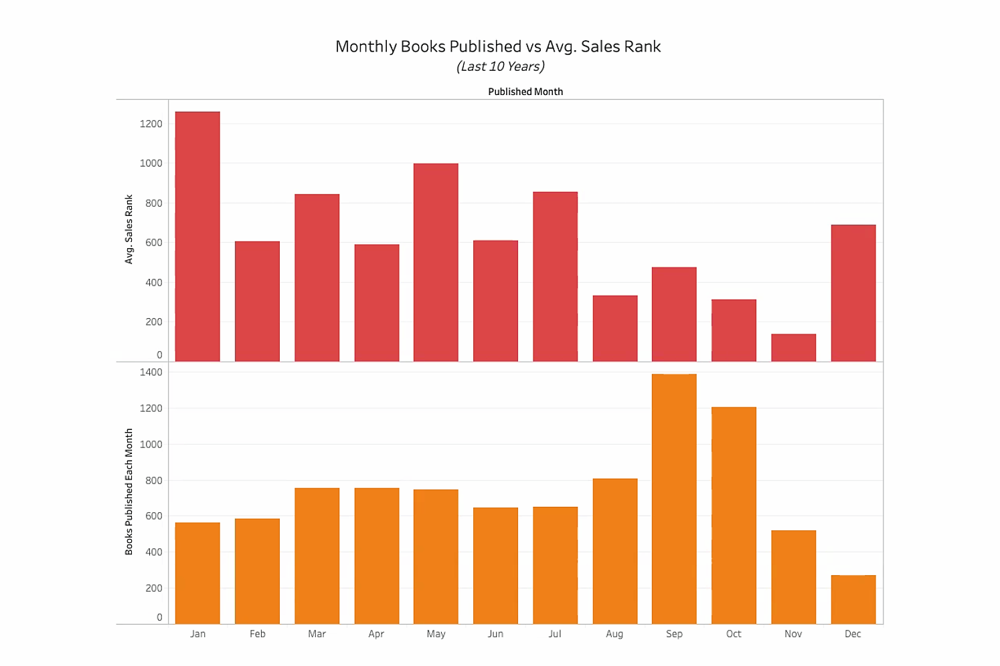

#### Ans: More books have been published around months August to December, and they have comparatively higher sales rank. One possible explanation for the higher number of books published during this time could be that the publishers are aware that people find more spare time to buy and read books during the period of winter holidays.

#### Q2) Which are the most published genres?

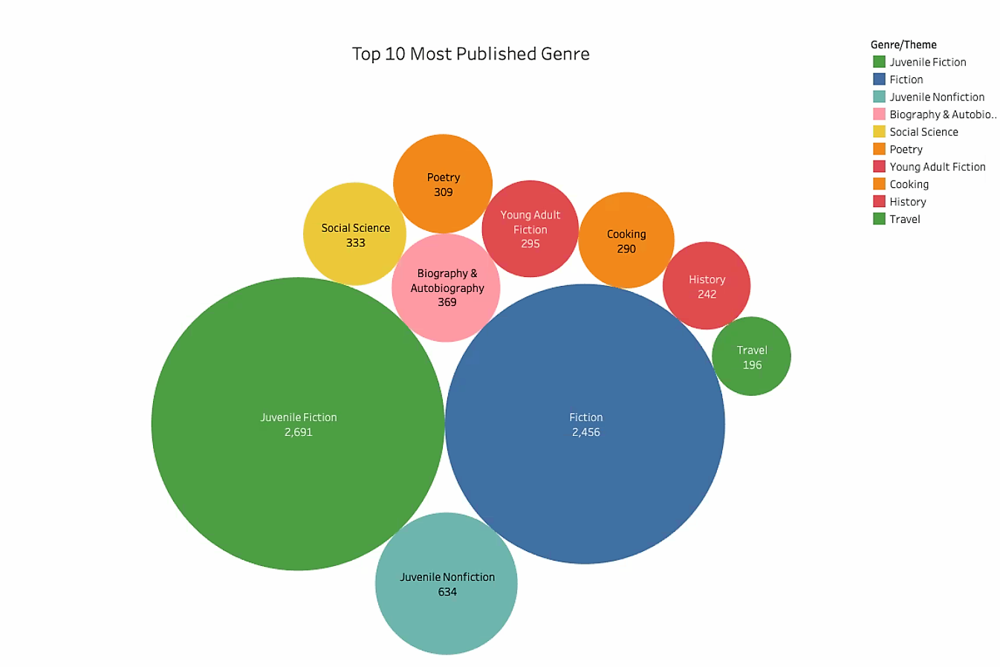

#### Ans: Juvenile Fiction, Fiction and Juvenile Non-Fiction are the most published books with 2691, 2456 and 634 books respectively. 

#### Q3) Which genres are the most expensive?

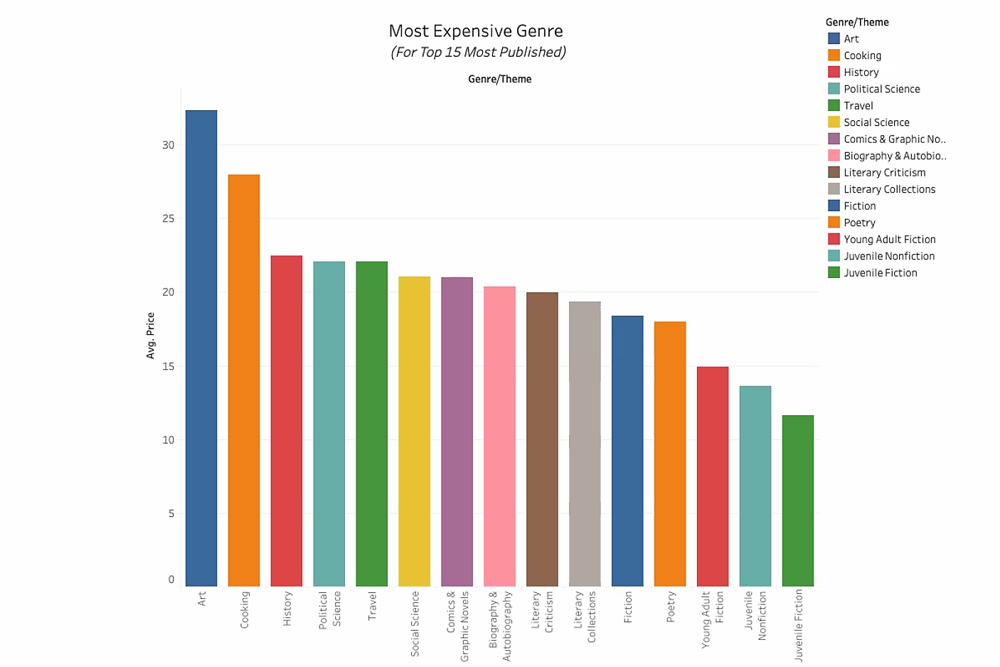

#### Ans: Art and Cooking books are the most expensive books

#### Q4) How does the price vary for genres across the years?

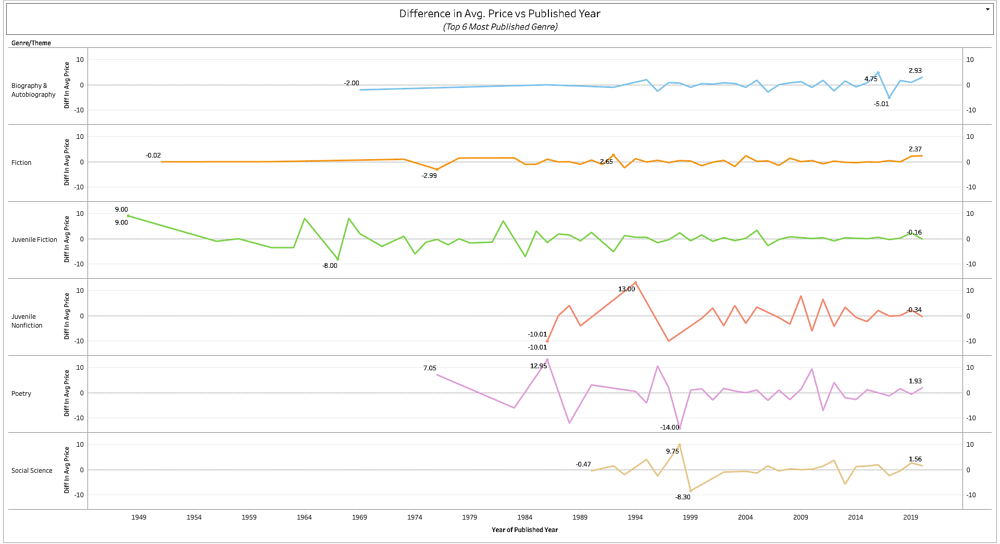

#### Ans: The average price for Fiction books has remained steady over the years while Poetry book price have varied the most throughout the years.

# Part 3) Text Analysis
## Performing text analysis on all the scraped reviews for 10,000 books.

In [46]:
#Reading the saved csv file that was scraped 
scraped_reviews_copy = pd.read_csv('Scraped_Book_Reviews.csv')

In [49]:
scraped_reviews_copy

,Book Title,Critic Reviews
0,A Promised Land,“Barack Obama is as fine a writer as they come...
1,A Promised Land,"Chimamanda Ngozi Adichie, The New York Times B..."
2,Caste (Oprah's Book Club),“Magnificent . . . a trailblazing work on the ...
3,Caste (Oprah's Book Club),O: The Oprah Magazine“This book has the reverb...
4,Caste (Oprah's Book Club),"Dwight Garner, The New York Times“A surprising..."
...,...,...
112889,"Typewriters, Bombs, Jellyfish",[...less]
112890,Big Bad Bubble,"* ""Rubin's voice-over narrator counsels Yerbur..."
112891,Big Bad Bubble,that moment when the monsters
112892,Big Bad Bubble,or whatever lurks under their particular beds


In [48]:
#Removing the etra index column which is present after reading the file
scraped_reviews_copy = scraped_reviews_copy.drop(['Unnamed: 0'], axis=1)

In [50]:
#Importing required libraries
import nltk
import re
#nltk.download()
stopword = nltk.corpus.stopwords.words('english')
ps = nltk.PorterStemmer()
wn = nltk.WordNetLemmatizer()
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np

In [24]:
#Defining a function to clean text (performing pre-processing operations,eliminating stopwords)
def clean(text):
    
    #Remove punctuation by removing non-space and alpha-num characters
    text=re.sub(r'[^\w\s]',' ',text).lower() 
    #Split by remaining non-alphanumeric characters
    words=re.split(r'\W+', text)
    #Remove Stopwords
    non_stop_words=[word for word in words if word not in stopword]       
    #Lemmatizing 
    lem_words= [wn.lemmatize(word) for word in non_stop_words]             
    clean_text= ' '.join(lem_words)
    return clean_text

In [52]:
scraped_reviews_copy_clean = scraped_reviews_copy

In [53]:
scraped_reviews_copy_clean

,Book Title,Critic Reviews
0,A Promised Land,“Barack Obama is as fine a writer as they come...
1,A Promised Land,"Chimamanda Ngozi Adichie, The New York Times B..."
2,Caste (Oprah's Book Club),“Magnificent . . . a trailblazing work on the ...
3,Caste (Oprah's Book Club),O: The Oprah Magazine“This book has the reverb...
4,Caste (Oprah's Book Club),"Dwight Garner, The New York Times“A surprising..."
...,...,...
112889,"Typewriters, Bombs, Jellyfish",[...less]
112890,Big Bad Bubble,"* ""Rubin's voice-over narrator counsels Yerbur..."
112891,Big Bad Bubble,that moment when the monsters
112892,Big Bad Bubble,or whatever lurks under their particular beds


In [556]:
#Peforming cleaning operations to the critic review column
scraped_reviews_copy_clean["Clean_Critic Reviews"]= scraped_reviews_copy_clean["Critic Reviews"].apply(clean)
scraped_reviews_copy_clean


,Book Title,Critic Reviews,Clean_Critic Reviews
0,A Promised Land,"“Barack Obama is as fine a writer as they come. . . . [A Promised Land] is nearly always pleasurable to read, sentence by sentence, the prose gorgeous in places, the detail granular and vivid. . . . The story will continue in the second volume, but Barack Obama has already illuminated a pivotal moment in American history, and how America changed while also remaining unchanged.”",barack obama fine writer come promised land nearly always pleasurable read sentence sentence prose gorgeous place detail granular vivid story continue second volume barack obama already illuminated pivotal moment american history america changed also remaining unchanged
1,A Promised Land,"Chimamanda Ngozi Adichie, The New York Times Book Review",chimamanda ngozi adichie new york time book review
3,Caste (Oprah's Book Club),"“Magnificent . . . a trailblazing work on the birth of inequality . . . Caste offers a forward-facing vision. Bursting with insight and love, this book may well help save us.”",magnificent trailblazing work birth inequality caste offer forward facing vision bursting insight love book may well help save u
4,Caste (Oprah's Book Club),"O: The Oprah Magazine“This book has the reverberating and patriotic slap of the best American prose writing. . . . Wilkerson has written a closely argued book that largely avoids the word ‘racism,’ yet stares it down with more humanity and rigor than nearly all but a few books in our literature. . . . It’s a book that changes the weather inside a reader.”",oprah magazine book reverberating patriotic slap best american prose writing wilkerson written closely argued book largely avoids word racism yet stare humanity rigor nearly book literature book change weather inside reader
5,Caste (Oprah's Book Club),"Dwight Garner, The New York Times“A surprising and arresting wide-angle reframing . . . Her epilogue feels like a prayer for a country in pain, offering new directions through prophetic language.”",dwight garner new york time surprising arresting wide angle reframing epilogue feel like prayer country pain offering new direction prophetic language
...,...,...,...
114770,"Typewriters, Bombs, Jellyfish",[...less],le
114771,Big Bad Bubble,"* ""Rubin's voice-over narrator counsels Yerburt, Froofle, and Wumpus through their anxiety, coaching them, therapist-style, through their first encounter with actual bubbles. Salmieri's pen-and-ink lines give unexpected delicacy to the story [and] readers will take the hint about unreasonable fears, they’ll be back for giggle-fueled rereadings.""--Publisher's Weekly, starred review""The fearful Wild Thing–like monsters are comically depicted, and their problems are resolved with perfect pacing.""--School Library Journal""Funny words and pictures combine to delight . . . this amusing romp will encourage young readers to put their own fears in perspective.""--The Wall Street Journal""Big Bad Bubblemight help kids get a bit of perspective on their own fears, and should certainly make them laugh at bedtime",rubin voice narrator counsel yerburt froofle wumpus anxiety coaching therapist style first encounter actual bubble salmieri pen ink line give unexpected delicacy story reader take hint unreasonable fear back giggle fueled rereadings publisher weekly starred review fearful wild thing like monster comically depicted problem resolved perfect pacing school library journal funny word picture combine delight amusing romp encourage young reader put fear perspective wall street journal big bad bubblemight help kid get bit perspective fear certainly make laugh bedtime
114772,Big Bad Bubble,that moment when the monsters,moment monster
114773,Big Bad Bubble,or whatever lurks under their particular beds,whatever lurks particular bed


In [55]:
#Using TextBlob for analysis
from textblob import TextBlob 

In [56]:
#Defining a function to calculate sentiment measures
def get_sentiment(text):
    blob=TextBlob(text)
    return blob.sentiment

In [57]:
scraped_reviews_copy_clean['sentiment'] = scraped_reviews_copy_clean['Clean_Critic Reviews'].apply(get_sentiment)

In [60]:
scraped_reviews_copy_clean

,Book Title,Critic Reviews,Clean_Critic Reviews,sentiment
0,A Promised Land,“Barack Obama is as fine a writer as they come...,barack obama fine writer come promised land n...,"(0.2630952380952381, 0.47857142857142854)"
1,A Promised Land,"Chimamanda Ngozi Adichie, The New York Times B...",chimamanda ngozi adichie new york time book re...,"(0.13636363636363635, 0.45454545454545453)"
2,Caste (Oprah's Book Club),“Magnificent . . . a trailblazing work on the ...,magnificent trailblazing work birth inequalit...,"(0.75, 0.8)"
3,Caste (Oprah's Book Club),O: The Oprah Magazine“This book has the reverb...,oprah magazine book reverberating patriotic sl...,"(0.32857142857142857, 0.28214285714285714)"
4,Caste (Oprah's Book Club),"Dwight Garner, The New York Times“A surprising...",dwight garner new york time surprising arresti...,"(0.21818181818181817, 0.45227272727272727)"
...,...,...,...,...
112889,"Typewriters, Bombs, Jellyfish",[...less],le,"(0.0, 0.0)"
112890,Big Bad Bubble,"* ""Rubin's voice-over narrator counsels Yerbur...",rubin voice narrator counsel yerburt froofle ...,"(0.12095238095238096, 0.5780952380952381)"
112891,Big Bad Bubble,that moment when the monsters,moment monster,"(0.0, 0.0)"
112892,Big Bad Bubble,or whatever lurks under their particular beds,whatever lurks particular bed,"(0.16666666666666666, 0.3333333333333333)"


In [ ]:
#Separating sentiment into polartiy and subjectivity
scraped_reviews_copy_clean['sentiment'][0][0]
scraped_reviews_copy_clean['Polarity'] = scraped_reviews_copy_clean['sentiment'].apply(lambda x: x[0])
scraped_reviews_copy_clean['Subjectivity'] = scraped_reviews_copy_clean['sentiment'].apply(lambda x: x[1])

In [66]:
scraped_reviews_copy_clean

,Book Title,Critic Reviews,Clean_Critic Reviews,sentiment,Polarity,Subjectivity
0,A Promised Land,“Barack Obama is as fine a writer as they come...,barack obama fine writer come promised land n...,"(0.2630952380952381, 0.47857142857142854)",0.263095,0.478571
1,A Promised Land,"Chimamanda Ngozi Adichie, The New York Times B...",chimamanda ngozi adichie new york time book re...,"(0.13636363636363635, 0.45454545454545453)",0.136364,0.454545
2,Caste (Oprah's Book Club),“Magnificent . . . a trailblazing work on the ...,magnificent trailblazing work birth inequalit...,"(0.75, 0.8)",0.750000,0.800000
3,Caste (Oprah's Book Club),O: The Oprah Magazine“This book has the reverb...,oprah magazine book reverberating patriotic sl...,"(0.32857142857142857, 0.28214285714285714)",0.328571,0.282143
4,Caste (Oprah's Book Club),"Dwight Garner, The New York Times“A surprising...",dwight garner new york time surprising arresti...,"(0.21818181818181817, 0.45227272727272727)",0.218182,0.452273
...,...,...,...,...,...,...
112889,"Typewriters, Bombs, Jellyfish",[...less],le,"(0.0, 0.0)",0.000000,0.000000
112890,Big Bad Bubble,"* ""Rubin's voice-over narrator counsels Yerbur...",rubin voice narrator counsel yerburt froofle ...,"(0.12095238095238096, 0.5780952380952381)",0.120952,0.578095
112891,Big Bad Bubble,that moment when the monsters,moment monster,"(0.0, 0.0)",0.000000,0.000000
112892,Big Bad Bubble,or whatever lurks under their particular beds,whatever lurks particular bed,"(0.16666666666666666, 0.3333333333333333)",0.166667,0.333333


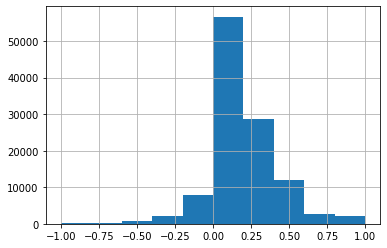

In [68]:
scraped_reviews_copy_clean.Polarity.hist()

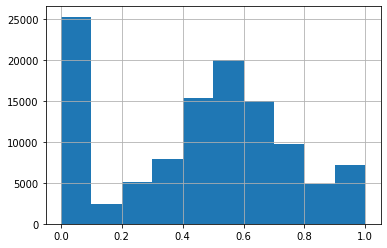

In [69]:
scraped_reviews_copy_clean.Subjectivity.hist()

In [212]:
scraped_reviews_copy_clean.to_csv("Final.csv")

In [80]:
subjectivity_filtered = scraped_reviews_copy_clean[scraped_reviews_copy_clean.Subjectivity > 0.1]

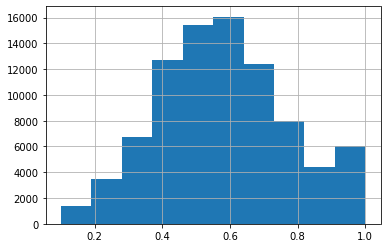

In [81]:
subjectivity_filtered.Subjectivity.hist()

In [323]:
Final_ds = pd.read_csv("Final.csv")

,Title,Author,Price,Sales Rank,Genre/Theme,Published Month,Published Year,Mean_Polarity,Mean_Subjectivity
0,A Promised Land,Barack Obama,45.00,1,History,Nov,2020,0.199729,0.466558
1,The Cold Millions,Jess Walter,28.99,2,Fiction,Oct,2020,0.202203,0.639696
2,Caste (Oprah's Book Club),Isabel Wilkerson,28.80,3,History,Aug,2020,0.181603,0.431806
3,The Deep End (Diary of a Wimpy Kid Book 15),Jeff Kinney,13.49,4,Juvenile Fiction,Oct,2020,0.188393,0.349554
4,Rhythm of War,Brandon Sanderson,34.99,5,Fiction,Nov,2020,0.254038,0.486132
...,...,...,...,...,...,...,...,...,...
7495,The Bed Moved,Rebecca Schiff,15.95,79327,Fiction,Feb,2017,0.265144,0.513147
7496,The Yellow Bird Sings,Jennifer Rosner,25.99,79344,Fiction,Mar,2020,0.243665,0.519479
7497,The Flapper Queens,Trina Robbins,34.99,79349,History,Aug,2020,0.000000,0.000000
7498,Nico Bravo and the Hound of Hades,Mike Cavallaro,12.99,79350,Juvenile Fiction,Apr,2019,0.151562,0.253125


In [229]:
#Word cloud
scraped_reviews_copy_clean

,Book Title,Critic Reviews,Clean_Critic Reviews,sentiment,Polarity,Subjectivity
0,A Promised Land,“Barack Obama is as fine a writer as they come...,barack obama fine writer come promised land n...,"(0.2630952380952381, 0.47857142857142854)",0.263095,0.478571
1,A Promised Land,"Chimamanda Ngozi Adichie, The New York Times B...",chimamanda ngozi adichie new york time book re...,"(0.13636363636363635, 0.45454545454545453)",0.136364,0.454545
2,Caste (Oprah's Book Club),“Magnificent . . . a trailblazing work on the ...,magnificent trailblazing work birth inequalit...,"(0.75, 0.8)",0.750000,0.800000
3,Caste (Oprah's Book Club),O: The Oprah Magazine“This book has the reverb...,oprah magazine book reverberating patriotic sl...,"(0.32857142857142857, 0.28214285714285714)",0.328571,0.282143
4,Caste (Oprah's Book Club),"Dwight Garner, The New York Times“A surprising...",dwight garner new york time surprising arresti...,"(0.21818181818181817, 0.45227272727272727)",0.218182,0.452273
...,...,...,...,...,...,...
112889,"Typewriters, Bombs, Jellyfish",[...less],le,"(0.0, 0.0)",0.000000,0.000000
112890,Big Bad Bubble,"* ""Rubin's voice-over narrator counsels Yerbur...",rubin voice narrator counsel yerburt froofle ...,"(0.12095238095238096, 0.5780952380952381)",0.120952,0.578095
112891,Big Bad Bubble,that moment when the monsters,moment monster,"(0.0, 0.0)",0.000000,0.000000
112892,Big Bad Bubble,or whatever lurks under their particular beds,whatever lurks particular bed,"(0.16666666666666666, 0.3333333333333333)",0.166667,0.333333


In [231]:
Download the following packages, required for word cloud
#!pip install Pillow
#!pip install wordcloud

In [235]:
#Importing libraries for wordcloud

import numpy as np
import pandas as pd
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

import matplotlib.pyplot as plt 
%matplotlib inline

from matplotlib import rcParams

import collections
import matplotlib.cm as cm

In [245]:
#Checking words for word cloud
text = " ".join(review for review in scraped_reviews_copy_clean["Clean_Critic Reviews"])
print ("There are {} words in the combination of all critic review.".format(len(text)))

There are 17206948 words in the combination of all critic review.


In [246]:
text

' barack obama fine writer come promised land nearly always pleasurable read sentence sentence prose gorgeous place detail granular vivid story continue second volume barack obama already illuminated pivotal moment american history america changed also remaining unchanged  chimamanda ngozi adichie new york time book review  magnificent trailblazing work birth inequality caste offer forward facing vision bursting insight love book may well help save u  oprah magazine book reverberating patriotic slap best american prose writing wilkerson written closely argued book largely avoids word racism yet stare humanity rigor nearly book literature book change weather inside reader  dwight garner new york time surprising arresting wide angle reframing epilogue feel like prayer country pain offering new direction prophetic language  bilal qureshi washington post transformative new framework understand identity injustice america  justin worland time magisterial reporting nimble sentence exquisite r

In [ ]:
#Plotting most frequent words
filtered_words = [word for word in text.split() if word not in stopwords]
counted_words = collections.Counter(filtered_words)

words = []
counts = []
for letter, count in counted_words.most_common(50):
    words.append(letter)
    counts.append(count)

plt.title('Top words in the headlines vs their count')
plt.xlabel('Count')
plt.ylabel('Words')
plt.barh(words, counts, color='grey')
plt.savefig('testplot.png')

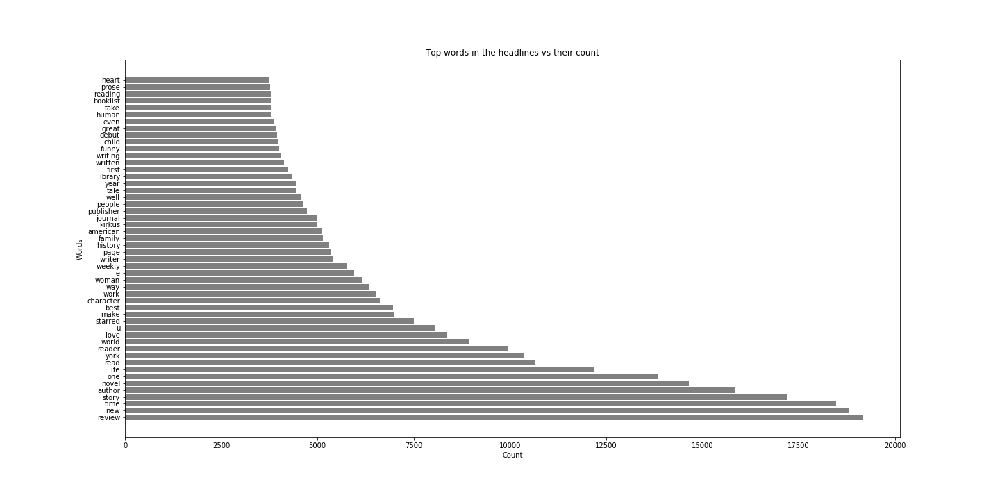

In [ ]:
# Create custom stopword list to remove words that add no meaning
stopwords = set(STOPWORDS)
stopwords.update(["review","new","story","author","one","read","york","reader","u","make","best",
                  "way","le","weekly","writer","page","kirkus","journal","publisher","time",
                  "first","written","writing","great","even","take","booklist","reading","book",
                  "write","full","put","sharp","word","might","told","right","last","subject",
                 "give","must","may","yet","much","know", "bring","offer","feel","starred"])

In [283]:
#Generating a custom word cloud from a outline image
wc_img = np.array(Image.open("Book_Cover.png"))
wc_img

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

In [284]:
def transform_format(val):
    if val == 0:
        return 255
    else:
        return val

In [285]:
# Transforming your mask into a new one that will work with the function:
transformed_wc_img = np.ndarray((wc_img.shape[0],wc_img.shape[1]), np.int32)

for i in range(len(wine_mask)):
    transformed_wc_img[i] = list(map(transform_format, wc_img[i]))

In [286]:
transformed_wc_img

array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]])

In [ ]:
# Create a word cloud image
wc = WordCloud(background_color="whitesmoke", max_words=500, mask=transformed_wc_img,
               stopwords=stopwords, contour_width=15, contour_color='goldenrod')

# Generate a wordcloud
wc.generate(text)


plt.figure(figsize=[30,30])
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.savefig('WC.jpg')

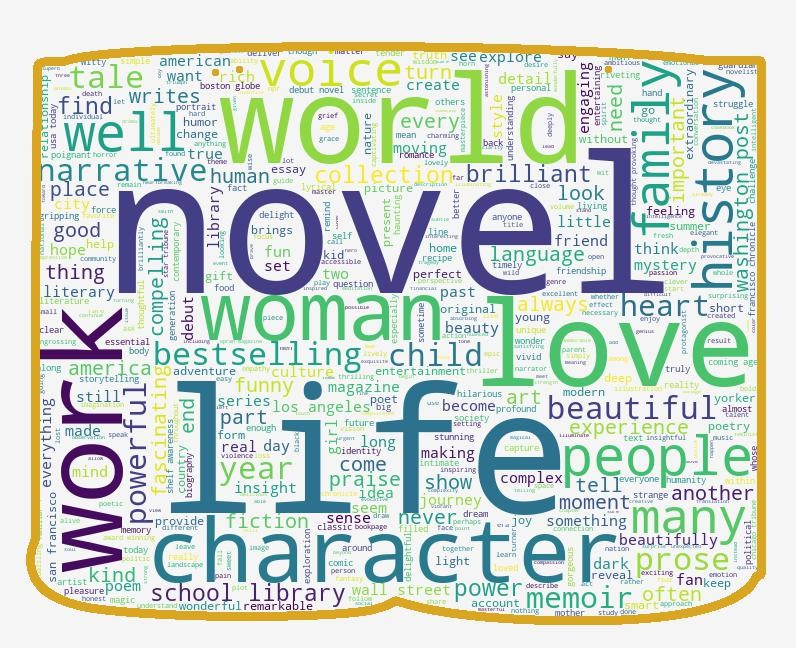

# Part 4) Results
## Using Tableau, we tried to answer the question: Do critic review matter?

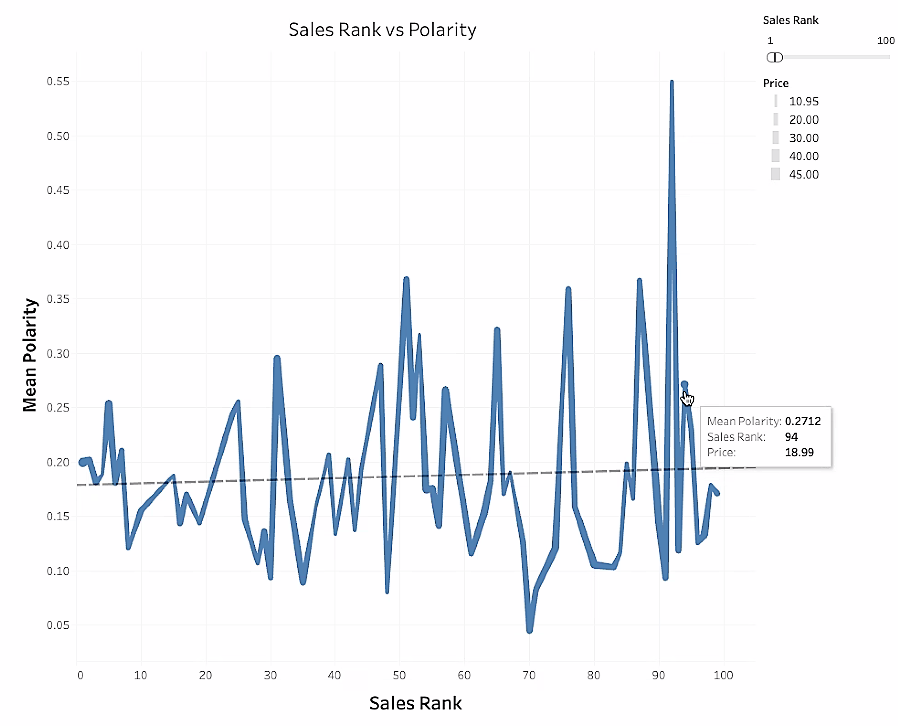

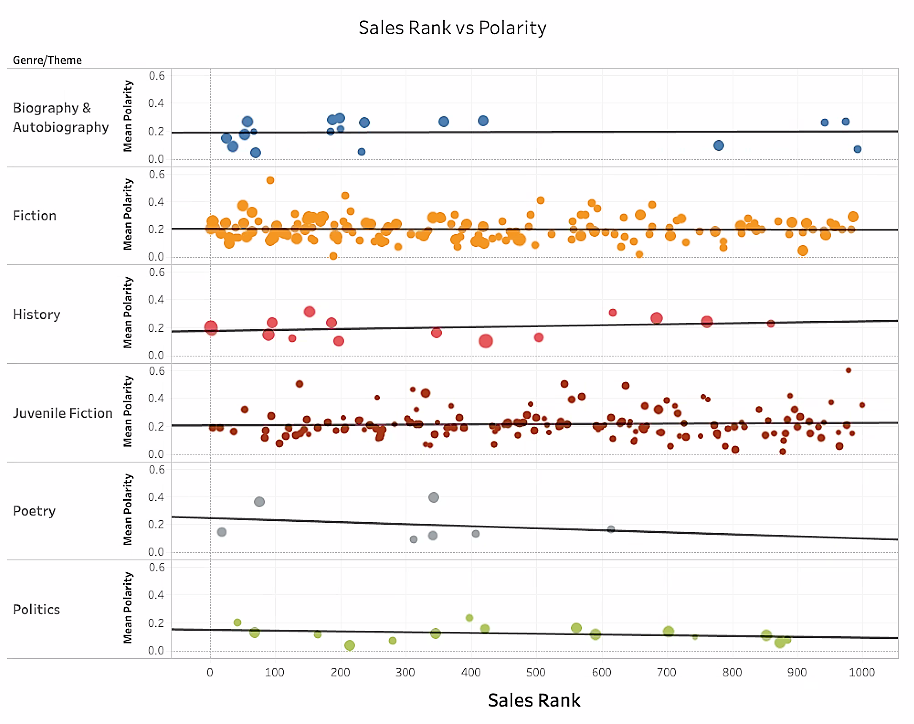